In [1]:
%matplotlib inline

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu
import seaborn as sns
from matplotlib.gridspec import GridSpec
import scanpy as sc
import muon as mu
import graphtools
import magic
from matplotlib.pyplot import rc_context
from matplotlib import gridspec
import os


from datashader.mpl_ext import dsshow
import datashader as ds

import matplotlib.colors
cmap = plt.cm.hsv
cmaplist = [cmap(i) for i in range(cmap.N)]
cmaplist = cmaplist[0:round(len(cmaplist)*0.7)]
cmaplist.reverse()
cmap = matplotlib.colors.LinearSegmentedColormap.from_list('', cmaplist, cmap.N)

import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

import sys
sys.path.append('../../../Code/')
from utils import read_dataset_log


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
from matplotlib import rcParams, font_manager
import matplotlib


rcParams['pdf.fonttype'] = 42
rcParams['ps.fonttype'] = 42
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Arial']

In [29]:
# cmap = plt.cm.hsv
# cmaplist = [cmap(i) for i in range(cmap.N)]
# cmaplist = cmaplist[0:round(len(cmaplist)*0.7)]
# cmaplist.reverse()
# cmap = matplotlib.colors.LinearSegmentedColormap.from_list('', cmaplist, cmap.N)
    
def gate(data, g1, g2, ind=None, vertical_gate=None, horizontal_gate=None, quadrant_gate=None,
         labfontsize=9, plot_labeled=False, upper_only=False, ax=None):
    
    
    if ax is None:
        fig = plt.figure(constrained_layout=True, figsize=(2., 2.), dpi=200)
        gs = gridspec.GridSpec(1, 1, figure=fig, left=0.2,
                       bottom=.2, right=.95, top=.92)
        ax = fig.add_subplot(gs[0])

    if ind  is None:
        ind = pd.Series(np.array([True]*data.shape[0]), data.index)
    
    
    x = data.loc[ind, g1]
    y = data.loc[ind, g2]
    
    dsshow(pd.DataFrame({'x':x, 'y':y}), ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
    ax.set_xlabel(g1, fontsize=labfontsize)
    ax.set_ylabel(g2, fontsize=labfontsize)

    
    if vertical_gate is not None:
        xlim = ax.get_xlim()
        ax.hlines(y=vertical_gate['vthresh'], xmin=xlim[0], xmax=xlim[1], linestyle='--', color='k', linewidth=1)
        ax.set_xlim(xlim)
        
            
        initial_res = (data.loc[ind, g2]>vertical_gate['vthresh']).replace({True:vertical_gate['above_name'], False:vertical_gate['below_name']})
        final_res = ind.copy()
        final_res.loc[ind] = initial_res
        final_res.loc[~ind] = np.nan
    elif horizontal_gate is not None:
        ylim = ax.get_ylim()
        ax.vlines(x=horizontal_gate['hthresh'], ymin=ylim[0], ymax=ylim[1], linestyle='--', color='k', linewidth=1)
        ax.set_ylim(ylim)
        
        initial_res = (data.loc[ind, g1]>horizontal_gate['hthresh']).replace({False:horizontal_gate['left_name'], True:horizontal_gate['right_name']})
        final_res = ind.copy()
        final_res.loc[ind] = initial_res
        final_res.loc[~ind] = np.nan
        
        
    elif quadrant_gate is not None:
        xlim = ax.get_xlim()
        ylim = ax.get_ylim()
        if not upper_only:
            ax.hlines(y=quadrant_gate['vthresh'], xmin=xlim[0]-1, xmax=xlim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_xlim(xlim)
            ax.vlines(x=quadrant_gate['hthresh'], ymin=ylim[0]-1, ymax=ylim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_ylim(ylim)
        else:
            ax.hlines(y=quadrant_gate['vthresh'], xmin=quadrant_gate['hthresh'], xmax=xlim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_xlim(xlim)
            ax.vlines(x=quadrant_gate['hthresh'], ymin=quadrant_gate['vthresh'], ymax=ylim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_ylim(ylim)            
            

        indh = data.loc[ind, g1]> quadrant_gate['hthresh']
        indv = data.loc[ind, g2]> quadrant_gate['vthresh']
        final_res = ind.replace(False,np.nan)
        for hval,vval, lab in [[False, False, quadrant_gate['ll']], [True, False, quadrant_gate['lr']], [False, True, quadrant_gate['ul']], [True, True, quadrant_gate['ur']]]:
            tolab = (indh==hval) & (indv==vval)
            final_res.loc[tolab.index[tolab]] = lab
            
            
    if plot_labeled:
        fig = plt.figure(constrained_layout=True, figsize=(2.4, 2.), dpi=200)
        gs = gridspec.GridSpec(1, 1, figure=fig, left=0.2,
                       bottom=.2, right=.8, top=.92)
        ax2 = fig.add_subplot(gs[0])
        dat = pd.concat([x,y,final_res], axis=1)
        dat.columns = [g1, g2, 'label']
        for (k,g) in dat.groupby('label'):
            ax2.scatter(g[g1], g[g2], label=k, s=.5, edgecolor='None')
        ax2.legend(bbox_to_anchor=(1,1), markerscale=3, fontsize=6)
        
        
        
    return(final_res, ax)

In [3]:
params = read_dataset_log('Dataset Paths')
params.index = params['dataset']
params

,dataset,usage_fn,gene_scores_fn,gene_tpm_fn,tcat_fn,tcat_fn_withsingletons,manual_gating_fn,manual_activation_gating_fn,activation_score_fn,metadata_fn,...,k,dt,processed_forcnmf_fn,tpm_counts_for_cnmf_fn,raw_counts_filt_fn,raw_counts_fn,dataset_type,tissue_type,context_label,tcat_fn_old
dataset,,,,,,,,,,,,,,,,,,,,,
AMP-RA,AMP-RA,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/AMPRA/Manual...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/Activa...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,...,34.0,0_15,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,discovery,Synovium,RA+OA,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
Pan-Cancer,Pan-Cancer,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Ac...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,...,38.0,0.15,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,discovery,Pan-Tissue,Cancer+Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
TBRU,TBRU,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/TBRU/ManualG...,/data/srlab1/TCAT/Data/PerDataset/TBRU/Activat...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,...,36.0,0_20,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,discovery,Blood,Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
HIV-Vaccine,HIV-Vaccine,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Manu...,NaN,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Acti...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,...,31.0,0_15,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,discovery,Blood,Post-Vaccine+Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
UK-Covid,UK-Covid,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Manu...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Manu...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Acti...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,...,44.0,0_20,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,NaN,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,discovery,Blood,Covid-19+Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
COMBAT,COMBAT,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/TCA

# Prepare markers

In [4]:
# raw_counts_fn = '/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBAT-CITESeq-DATA.Raw.T.ADTfixed.h5ad'

In [5]:
outdir = '../../../Data/PerDataset/COMBAT'

In [6]:
figdir = '../../../Figures/Components'

In [7]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ForMAGIC.h5ad')
print(outfn)

../../../Data/PerDataset/COMBAT/ADT_TP10KCLR_ForMAGIC.h5ad


In [41]:
adata_ADT = sc.read(outfn)

In [566]:
set(rna_markers) - set(adata_RNA.var.index)

set()

In [42]:
adt_markers = ['AB_CD25','AB_CD38-1', 'AB_CD279', 'AB_CD54', 'AB_CD69', 'AB_CD71', 'AB_CD274',
              'AB_CD95']
    
#     'AB_CD3-1', 'AB_CD4-2',
#                'AB_CD8', 'AB_CD45RA', 'AB_CD45RO',  'AB_CD18', 'AB_CD161',  'AB_CD194', 'AB_CD195', 'AB_CD196', 'AB_CXCR3',
#                'AB_CD25', 'AB_CD127', 
#                'AB_CD27-1',
#                'AB_TCR-Vd2', 'AB_TCR-V-7.2', 'AB_TCR-V-9', 'AB_abTCR', 'AB_gdTCR',
#                'AB_CD31', 'AB_CD62L', 'AB_CCR7',
#                'AB_CD314',
#                'AB_CD38-1', 'AB_CD39',
#               'AB_CD94', 'AB_CD49b', 'AB_CD28'
              # ] 
    

In [211]:
sorted(adata_ADT.var.index)

['AB_B7-H4',
 'AB_CCR3',
 'AB_CCR7',
 'AB_CD10',
 'AB_CD101',
 'AB_CD103',
 'AB_CD106',
 'AB_CD107a',
 'AB_CD112',
 'AB_CD117',
 'AB_CD11a',
 'AB_CD11b-1',
 'AB_CD11c',
 'AB_CD122',
 'AB_CD123',
 'AB_CD124',
 'AB_CD127',
 'AB_CD133-2',
 'AB_CD137',
 'AB_CD137L',
 'AB_CD138-2',
 'AB_CD14-1',
 'AB_CD141',
 'AB_CD144',
 'AB_CD146',
 'AB_CD15',
 'AB_CD150',
 'AB_CD152',
 'AB_CD154',
 'AB_CD155',
 'AB_CD158',
 'AB_CD158b',
 'AB_CD158e1',
 'AB_CD158f',
 'AB_CD16',
 'AB_CD161',
 'AB_CD163',
 'AB_CD169',
 'AB_CD178',
 'AB_CD18',
 'AB_CD184',
 'AB_CD185',
 'AB_CD19',
 'AB_CD194',
 'AB_CD195',
 'AB_CD196',
 'AB_CD1a',
 'AB_CD1c',
 'AB_CD1d',
 'AB_CD2',
 'AB_CD20',
 'AB_CD204',
 'AB_CD206',
 'AB_CD207',
 'AB_CD209',
 'AB_CD21',
 'AB_CD22',
 'AB_CD223',
 'AB_CD224',
 'AB_CD226-2',
 'AB_CD23',
 'AB_CD235ab',
 'AB_CD24',
 'AB_CD244',
 'AB_CD25',
 'AB_CD252',
 'AB_CD254',
 'AB_CD257',
 'AB_CD258',
 'AB_CD26',
 'AB_CD267',
 'AB_CD268',
 'AB_CD269',
 'AB_CD27-1',
 'AB_CD272',
 'AB_CD273',
 'AB_CD274',


In [212]:
set(adt_markers) - set(adata_ADT.var.index)

set()

In [213]:
adt_markers = list(set(adt_markers).intersection(adata_ADT.var.index))

In [214]:
G = graphtools.Graph(data=adata_ADT.obsp['connectivities'], precomputed='affinity')
magic_operator = magic.MAGIC(t=3)
magic_operator.fit(adata_ADT.X, graph=G)
markers_magic_adt = magic_operator.transform(X=adata_ADT[:, adt_markers].X)
markers_magic_adt = pd.DataFrame(markers_magic_adt, index=adata_ADT.obs.index, columns=adt_markers)

Running MAGIC on 400925 cells and 192 genes.
Using precomputed graph and diffusion operator...


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/graphtools/base.py:554: RuntimeWarning: K should have a non-zero diagonal
  warnings.warn("K should have a non-zero diagonal", RuntimeWarning)


Calculating imputation...


/PHShome/mc1070/.local/lib/python3.7/site-packages/magic/magic.py:546: UserWarning: Running MAGIC.transform on different data to that which was used for MAGIC.fit may not produce sensible output, unless it comes from the same manifold.
  UserWarning,


Calculated imputation in 0.21 seconds.


In [215]:
markers_magic_adt

,AB_CD54,AB_CD69,AB_CD25,AB_CD38-1,AB_CD279,AB_CD95,AB_CD71,AB_CD274
AAACCTGAGCGGATCA-1-gPlexA1,3.747542,2.509148,0.516276,1.598792,1.918933,3.080082,0.669380,1.251240
AAACCTGCAGCTCGAC-1-gPlexA1,3.474700,2.346590,1.674545,1.160403,1.863265,3.095863,0.904969,1.306770
AAACCTGCATCTATGG-1-gPlexA1,4.457278,2.584516,0.665662,1.207341,3.406267,3.594516,0.784370,1.142198
AAACCTGGTCTCTCTG-1-gPlexA1,3.369131,2.635566,1.474057,1.214212,2.077005,3.002051,0.788879,1.007930
AAACCTGTCACCGGGT-1-gPlexA1,4.658725,3.756175,0.641566,3.625714,2.823839,4.032504,2.051935,1.231526
...,...,...,...,...,...,...,...,...
TTTGGTTTCCTCAACC-1-gPlexK7,3.367658,2.632424,1.314043,1.813468,1.651672,2.210848,0.731360,0.932983
TTTGGTTTCTCGATGA-1-gPlexK7,3.060671,2.554490,1.157296,1.268588,1.724891,3.174321,0.850678,1.410009
TTTGTCACACCACGTG-1-gPlexK7,3.872514,2.610206,0.676990,1.760464,1.739229,3.108563,0.801386,1.054491
TTTGTCAGTTACCGAT-1-gPlexK7,4.349252,3.479769,0.831912,1.086490,2.694810,3.410333,0.650962,0.991344


In [216]:
markers_magic = markers_magic_adt

In [217]:
outfn = os.path.join(outdir, 'MagicMarker.ActivationOnly.ADT_CLRTP10K.tsv')
print(outfn)

../../../Data/PerDataset/COMBAT/MagicMarker.ActivationOnly.ADT_CLRTP10K.tsv


In [218]:
markers_magic.to_csv(outfn, sep='\t')

In [219]:
unsmoothed_markers = pd.DataFrame(np.array(adata_ADT[:, adt_markers].X), 
                                  index=adata_ADT.obs.index,
                         columns=adt_markers)



In [220]:
outfn = os.path.join(outdir, 'UnsmoothedMarker.ActivationOnly.ADT_CLRTP10K.tsv')
print(outfn)

../../../Data/PerDataset/COMBAT/UnsmoothedMarker.ActivationOnly.ADT_CLRTP10K.tsv


In [221]:
unsmoothed_markers.to_csv(outfn, sep='\t')

# Gate on markers

In [8]:
markers_magic = pd.read_csv(os.path.join(outdir, 'MagicMarker.ActivationOnly.ADT_CLRTP10K.tsv'), 
                            index_col = 0, sep = '\t'
                           )

In [9]:
unsmoothed_markers = pd.read_csv(os.path.join(outdir, 'UnsmoothedMarker.ActivationOnly.ADT_CLRTP10K.tsv'), 
                            index_col = 0, sep = '\t'
                           )

In [10]:
dataset = 'COMBAT'

## All cells

In [11]:
from scipy.stats import pearsonr
from scipy.stats import spearmanr

In [12]:
markers_magic.columns

Index(['AB_CD54', 'AB_CD69', 'AB_CD25', 'AB_CD38-1', 'AB_CD279', 'AB_CD95',
       'AB_CD71', 'AB_CD274'],
      dtype='object')

AB_CD54 AB_CD54
AB_CD54 AB_CD69
AB_CD54 AB_CD25
AB_CD54 AB_CD38-1
AB_CD54 AB_CD279
AB_CD54 AB_CD71
AB_CD54 AB_CD274
AB_CD69 AB_CD54
AB_CD69 AB_CD69
AB_CD69 AB_CD25
AB_CD69 AB_CD38-1
AB_CD69 AB_CD279
AB_CD69 AB_CD71
AB_CD69 AB_CD274
AB_CD25 AB_CD54
AB_CD25 AB_CD69
AB_CD25 AB_CD25
AB_CD25 AB_CD38-1
AB_CD25 AB_CD279
AB_CD25 AB_CD71
AB_CD25 AB_CD274
AB_CD38-1 AB_CD54
AB_CD38-1 AB_CD69
AB_CD38-1 AB_CD25
AB_CD38-1 AB_CD38-1
AB_CD38-1 AB_CD279
AB_CD38-1 AB_CD71
AB_CD38-1 AB_CD274
AB_CD279 AB_CD54
AB_CD279 AB_CD69
AB_CD279 AB_CD25
AB_CD279 AB_CD38-1
AB_CD279 AB_CD279
AB_CD279 AB_CD71
AB_CD279 AB_CD274
AB_CD71 AB_CD54
AB_CD71 AB_CD69
AB_CD71 AB_CD25
AB_CD71 AB_CD38-1
AB_CD71 AB_CD279
AB_CD71 AB_CD71
AB_CD71 AB_CD274


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == "":
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


AB_CD274 AB_CD54
AB_CD274 AB_CD69
AB_CD274 AB_CD25
AB_CD274 AB_CD38-1
AB_CD274 AB_CD279
AB_CD274 AB_CD71
AB_CD274 AB_CD274


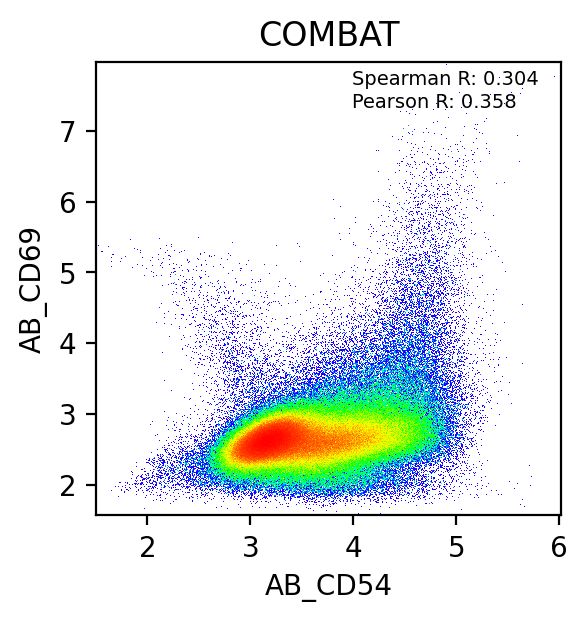

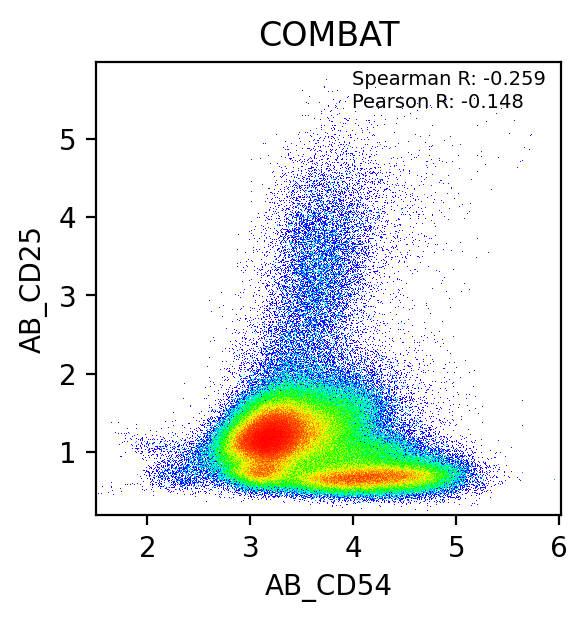

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


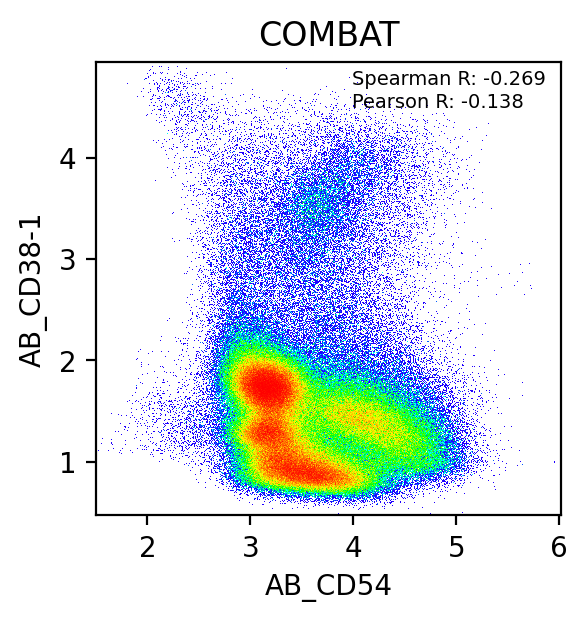

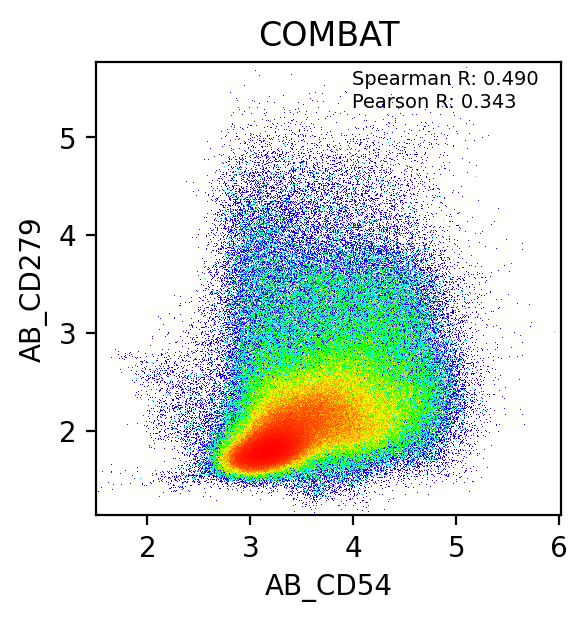

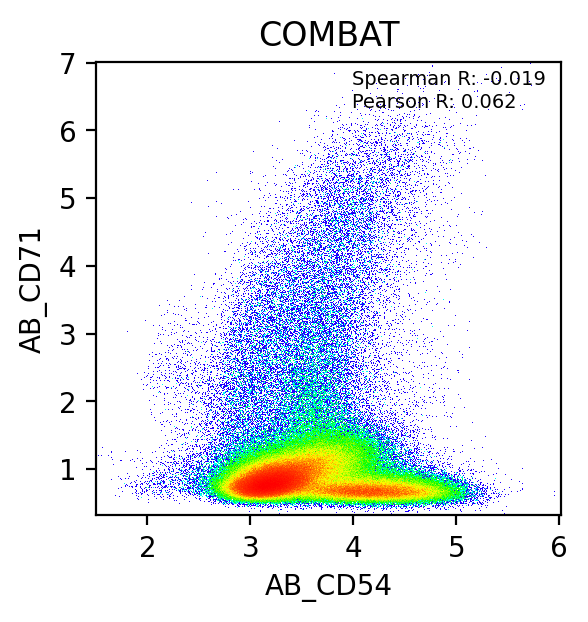

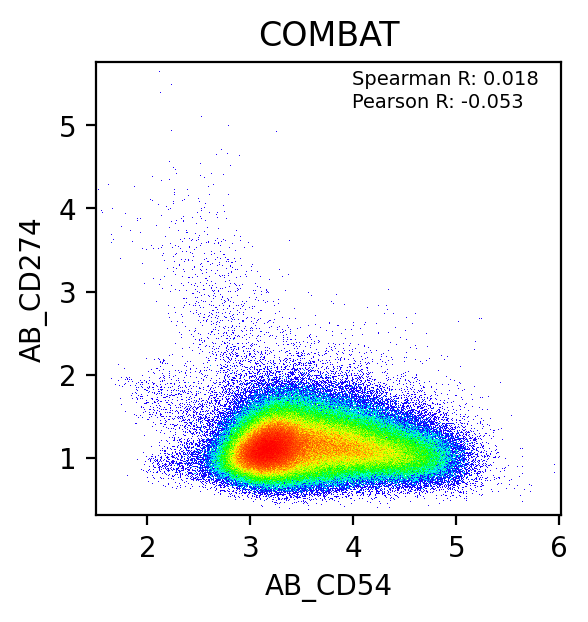

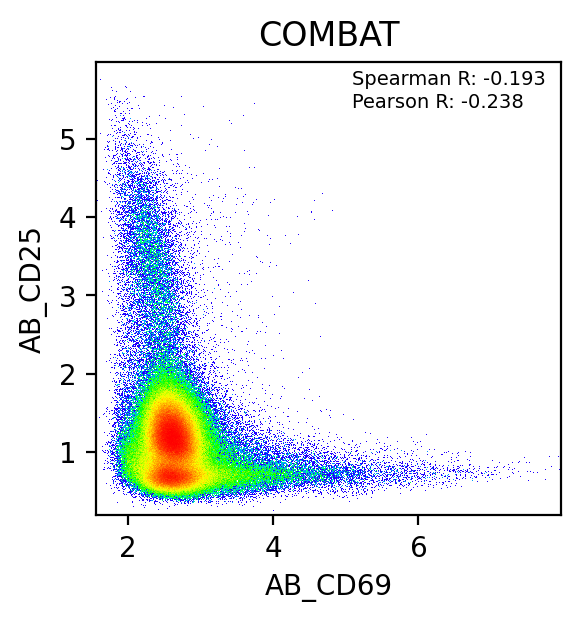

...

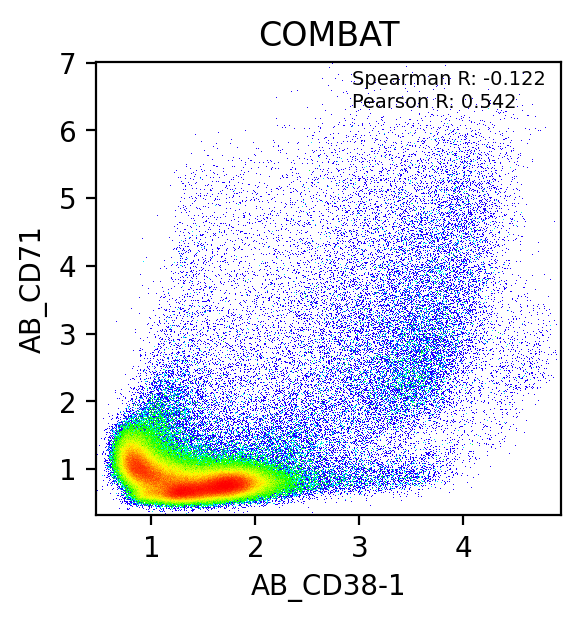

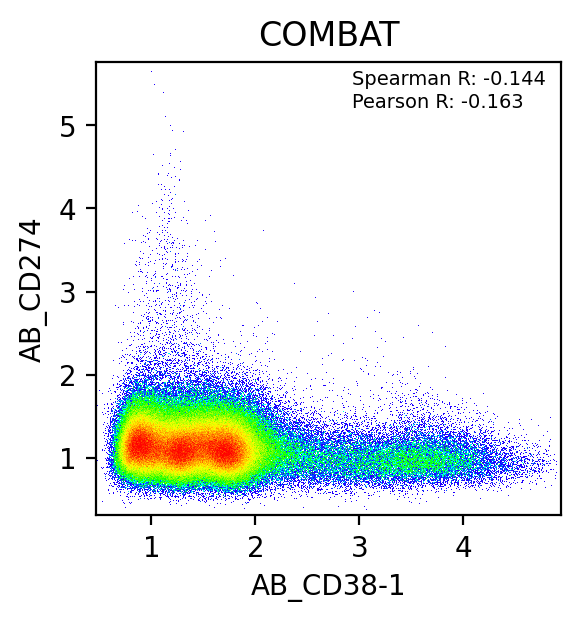

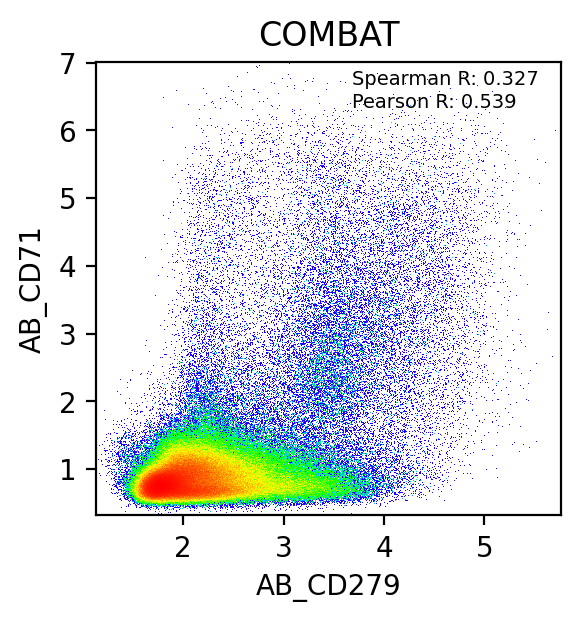

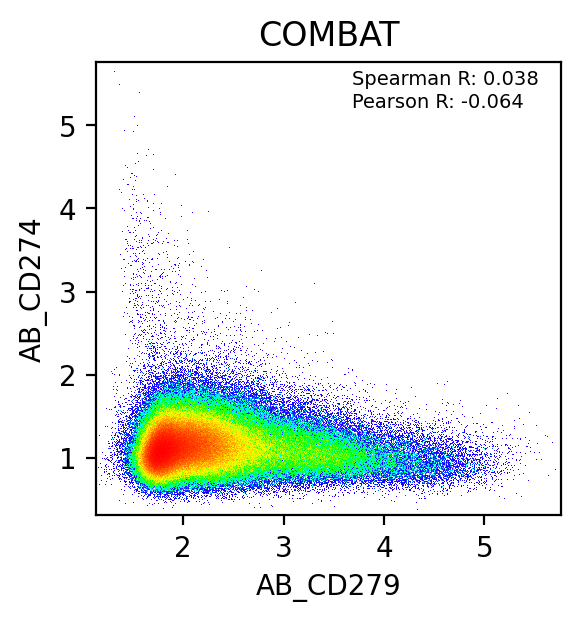

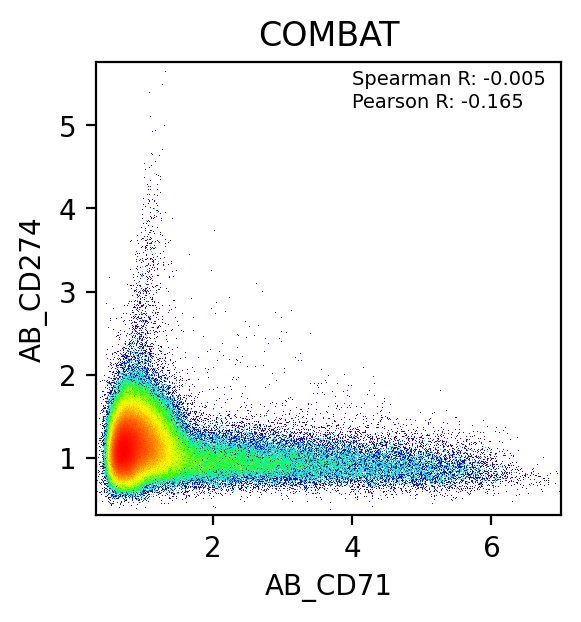

In [112]:

for i, p1 in enumerate(markers_magic.columns):
    
    for j, p2 in enumerate(markers_magic.columns):
        print(p1, p2)
        if j > i:
            x = markers_magic[p1]
            y = markers_magic[p2]
            
            r_p, _ = pearsonr(x, y)
            r_s, _ = spearmanr(x, y)

            fig, ax = plt.subplots(dpi = 200, figsize = (3, 3))
            # ax.scatter(x, y)
            dsshow(pd.DataFrame({'x':x, 'y':y}), 
                   ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
            # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
            ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
            ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
            ax.set_xlabel(p1)
            ax.set_ylabel(p2)
            ax.set_title('COMBAT')

0 AB_CD54
0 AB_CD54
1 AB_CD54
2 AB_CD54
3 AB_CD54
4 AB_CD54
5 AB_CD54
6 AB_CD54
1 AB_CD69
1 AB_CD69
2 AB_CD69
3 AB_CD69
4 AB_CD69
5 AB_CD69
6 AB_CD69
2 AB_CD25
2 AB_CD25
3 AB_CD25
4 AB_CD25
5 AB_CD25
6 AB_CD25
3 AB_CD38-1
3 AB_CD38-1
4 AB_CD38-1
5 AB_CD38-1
6 AB_CD38-1
4 AB_CD279
4 AB_CD279
5 AB_CD279
6 AB_CD279
5 AB_CD71
5 AB_CD71
6 AB_CD71
6 AB_CD274
6 AB_CD274


Text(0.5, 0.9, 'COMBAT')

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


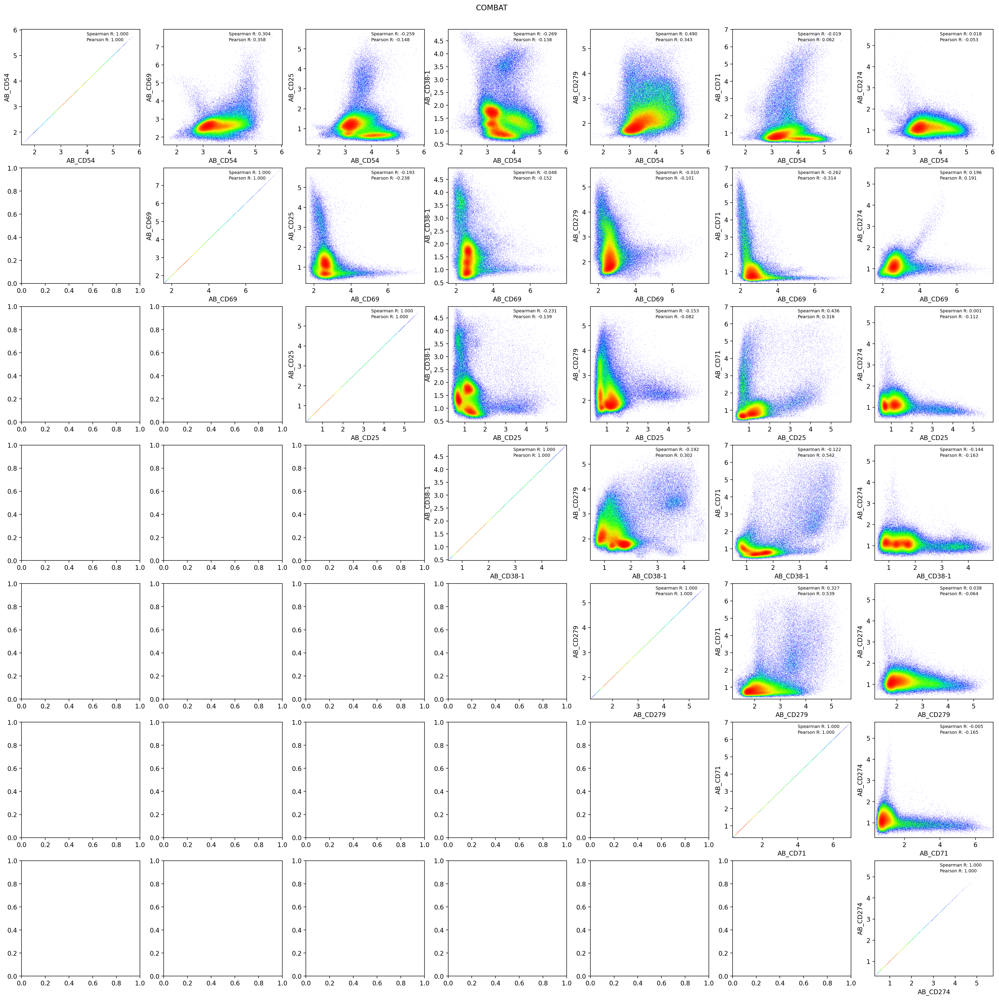

In [127]:
nrows = len(markers_magic.columns)
ncols = len(markers_magic.columns)
fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(markers_magic.columns)),
                                               nrows = nrows, ncols = ncols)

for i, p1 in enumerate(markers_magic.columns):
    print(i, p1)
    # i = i-1
    
    for j, p2 in enumerate(markers_magic.columns):
        # j = j-1
        if j >= i:
            print(j, p1)
            ax = axes[i, j]
            x = markers_magic[p1]
            y = markers_magic[p2]
            
            r_p, _ = pearsonr(x, y)
            r_s, _ = spearmanr(x, y)

            # ax.scatter(x, y)
            dsshow(pd.DataFrame({'x':x, 'y':y}), 
                   ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
            # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
            ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
            ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
            ax.set_xlabel(p1)
            ax.set_ylabel(p2)
plt.suptitle('COMBAT',y = 0.9)

AB_CD54 AB_CD54
AB_CD54 AB_CD69
AB_CD54 AB_CD25
AB_CD54 AB_CD38-1
AB_CD54 AB_CD279
AB_CD54 AB_CD71
AB_CD54 AB_CD274
AB_CD69 AB_CD54
AB_CD69 AB_CD69
AB_CD69 AB_CD25
AB_CD69 AB_CD38-1
AB_CD69 AB_CD279
AB_CD69 AB_CD71
AB_CD69 AB_CD274
AB_CD25 AB_CD54
AB_CD25 AB_CD69
AB_CD25 AB_CD25
AB_CD25 AB_CD38-1
AB_CD25 AB_CD279
AB_CD25 AB_CD71
AB_CD25 AB_CD274
AB_CD38-1 AB_CD54
AB_CD38-1 AB_CD69
AB_CD38-1 AB_CD25
AB_CD38-1 AB_CD38-1
AB_CD38-1 AB_CD279
AB_CD38-1 AB_CD71
AB_CD38-1 AB_CD274
AB_CD279 AB_CD54
AB_CD279 AB_CD69
AB_CD279 AB_CD25
AB_CD279 AB_CD38-1
AB_CD279 AB_CD279
AB_CD279 AB_CD71
AB_CD279 AB_CD274
AB_CD71 AB_CD54
AB_CD71 AB_CD69
AB_CD71 AB_CD25
AB_CD71 AB_CD38-1
AB_CD71 AB_CD279
AB_CD71 AB_CD71
AB_CD71 AB_CD274
AB_CD274 AB_CD54
AB_CD274 AB_CD69
AB_CD274 AB_CD25
AB_CD274 AB_CD38-1
AB_CD274 AB_CD279
AB_CD274 AB_CD71
AB_CD274 AB_CD274


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == "":


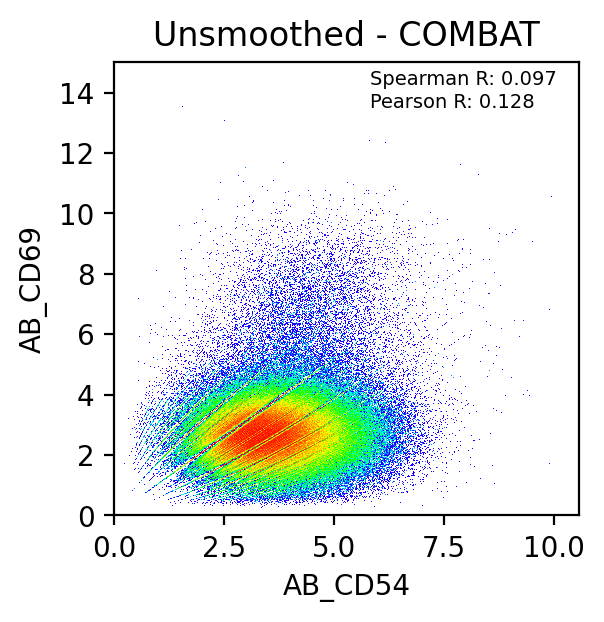

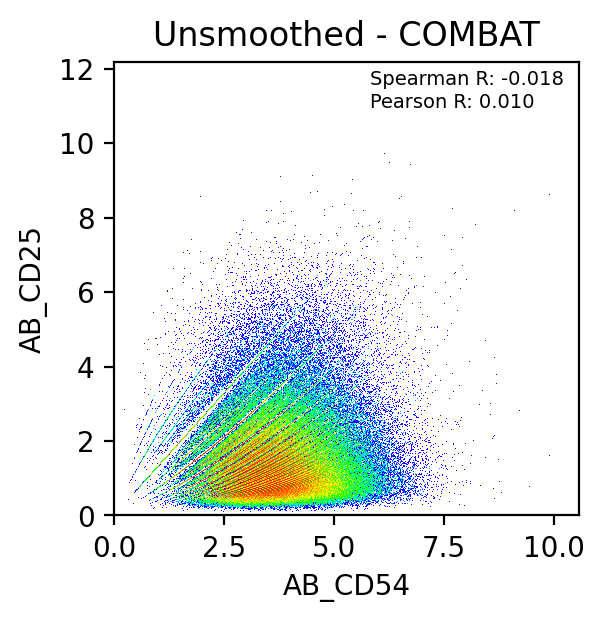

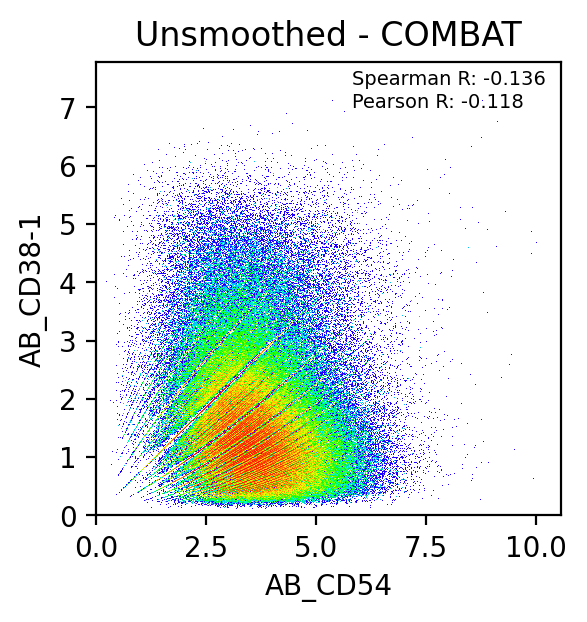

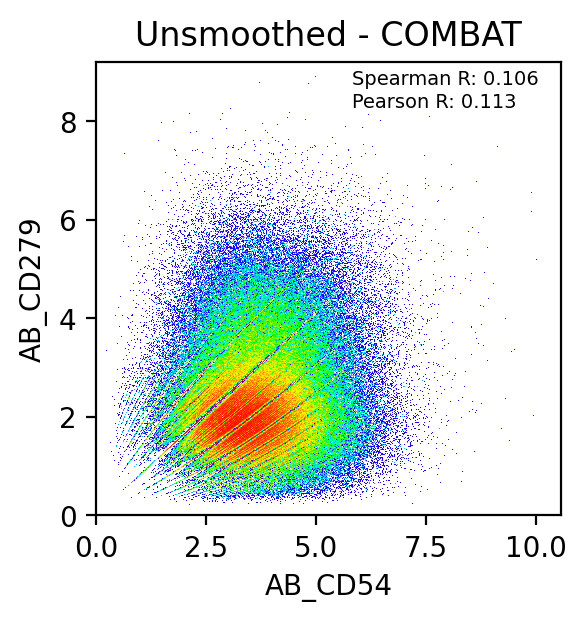

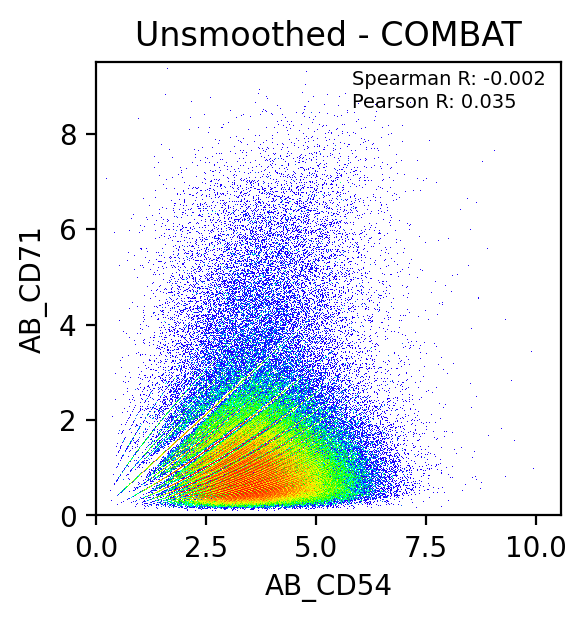

...

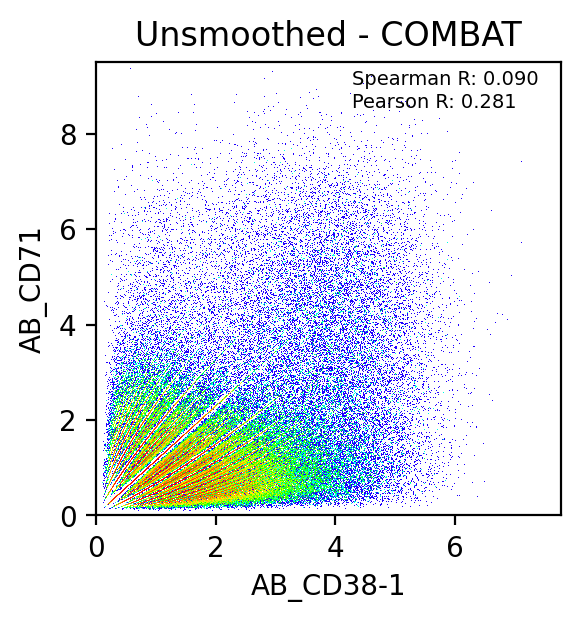

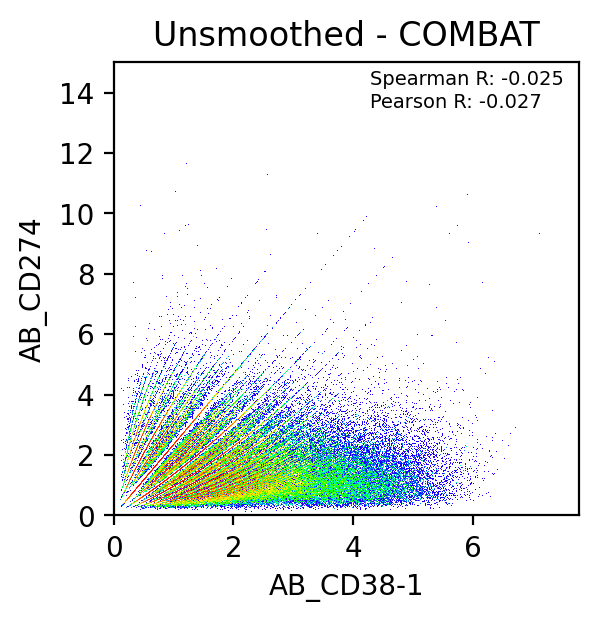

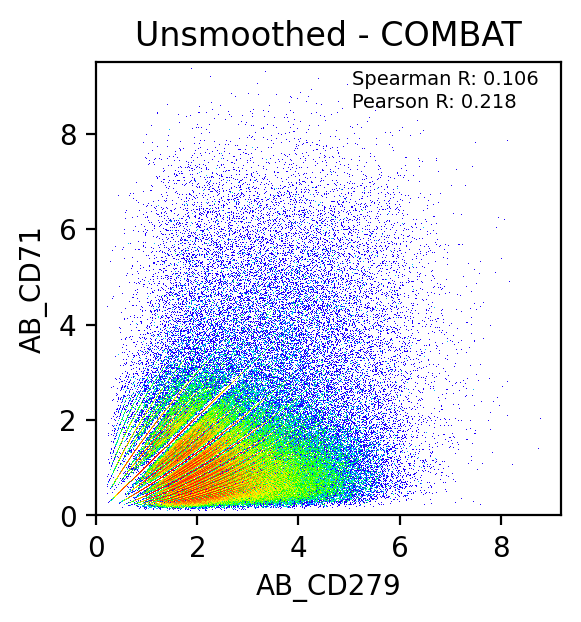

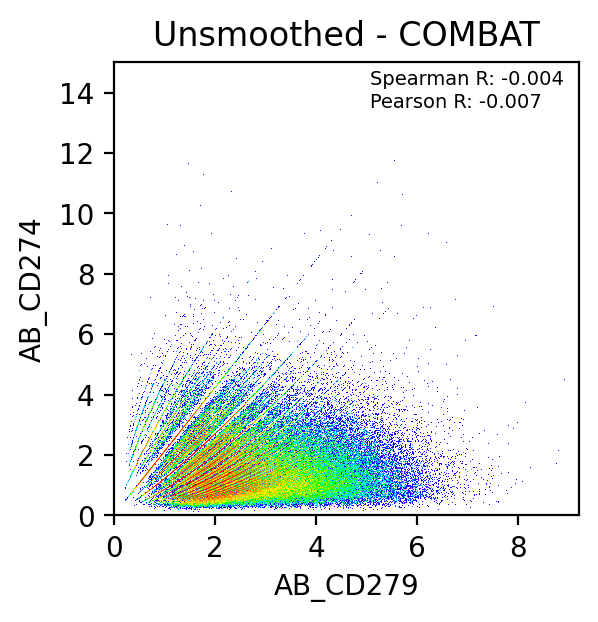

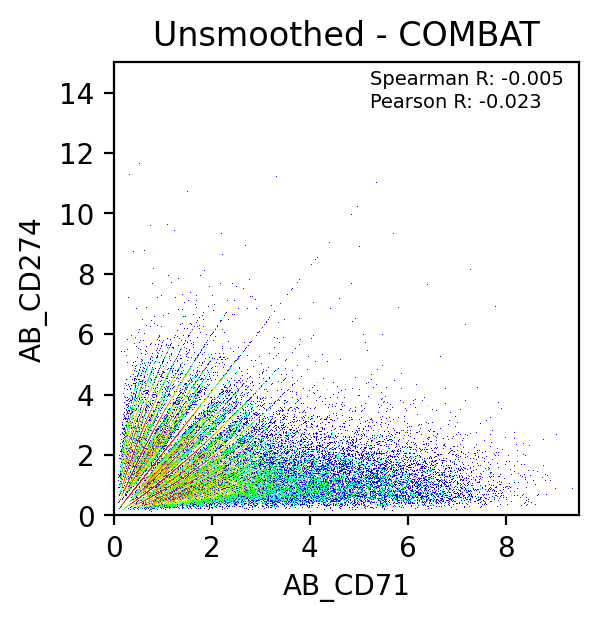

In [113]:
for i, p1 in enumerate(markers_magic.columns):
    
    for j, p2 in enumerate(markers_magic.columns):
        print(p1, p2)
        if j > i:
            x = unsmoothed_markers[p1]
            y = unsmoothed_markers[p2]
            
            r_p, _ = pearsonr(x, y)
            r_s, _ = spearmanr(x, y)

            fig, ax = plt.subplots(dpi = 200, figsize = (3, 3))
            # ax.scatter(x, y)
            dsshow(pd.DataFrame({'x':x, 'y':y}), 
                   ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
            # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
            ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
            ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
            ax.set_xlabel(p1)
            ax.set_ylabel(p2)
            ax.set_title('Unsmoothed - COMBAT')

In [44]:
gating = pd.DataFrame(index=markers_magic.index, columns=['Activated'])


In [39]:
p1 = 'AB_CD279'
p2 = 'AB_CD71'

In [47]:
gating

,Activated
AAACCTGAGCGGATCA-1-gPlexA1,NaN
AAACCTGCAGCTCGAC-1-gPlexA1,NaN
AAACCTGCATCTATGG-1-gPlexA1,NaN
AAACCTGGTCTCTCTG-1-gPlexA1,NaN
AAACCTGTCACCGGGT-1-gPlexA1,NaN
...,...
TTTGGTTTCCTCAACC-1-gPlexK7,NaN
TTTGGTTTCTCGATGA-1-gPlexK7,NaN
TTTGTCACACCACGTG-1-gPlexK7,NaN
TTTGTCAGTTACCGAT-1-gPlexK7,NaN


In [ ]:
gating['gdT'], ax = gate(markers_magic, g1, g2, ind=None, vertical_gate=vgate, plot_labeled=False)


Text(3.3, 6.5, 'Activated')

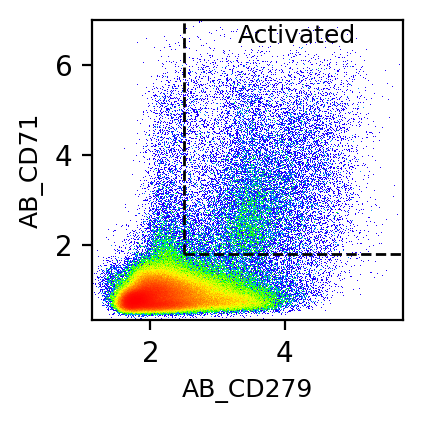

In [59]:
# g1 = 'AB_CD279'
# g2 = 'AB_CD71'   
# gating['Activated'], ax = gate(markers_magic, g1, g2, ind=None,
#                       quadrant_gate={'vthresh':1.8, 'hthresh':2.5, 'ur':'MAIT', 'ul':'ab', 'll':'ab', 'lr':'ab'}, plot_labeled=False, upper_only=True)
# ax.text(3.3,6.5, 'Activated', fontsize=9)
# # plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.png'))
# # plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.pdf'))

Text(3, 6.5, 'Activated')

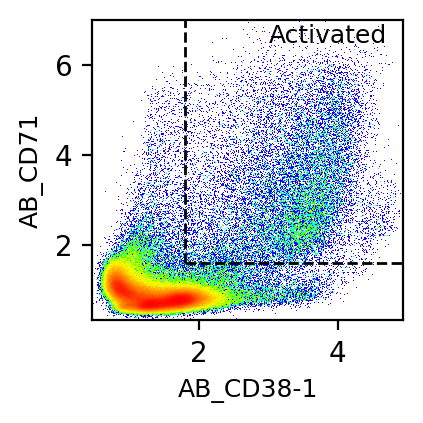

In [68]:
g1 = 'AB_CD38-1'
g2 = 'AB_CD71'   
gating['Activated'], ax = gate(markers_magic, g1, g2, ind=None,
                      quadrant_gate={'vthresh':1.6, 'hthresh':1.8, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3,6.5, 'Activated', fontsize=9)
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.png'))
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.pdf'))

In [69]:
gating['Activated']

AAACCTGAGCGGATCA-1-gPlexA1    Unactivated
AAACCTGCAGCTCGAC-1-gPlexA1    Unactivated
AAACCTGCATCTATGG-1-gPlexA1    Unactivated
AAACCTGGTCTCTCTG-1-gPlexA1    Unactivated
AAACCTGTCACCGGGT-1-gPlexA1      Activated
                                 ...     
TTTGGTTTCCTCAACC-1-gPlexK7    Unactivated
TTTGGTTTCTCGATGA-1-gPlexK7    Unactivated
TTTGTCACACCACGTG-1-gPlexK7    Unactivated
TTTGTCAGTTACCGAT-1-gPlexK7    Unactivated
TTTGTCATCCTCTAGC-1-gPlexK7    Unactivated
Name: Activated, Length: 400925, dtype: object

In [70]:
outfn = os.path.join(outdir, 'ManualGatingActivation.Magic.20230111.tsv')
print(outfn)

../../../Data/PerDataset/COMBAT/ManualGatingActivation.Magic.20230111.tsv


In [71]:
gating.to_csv(outfn, sep='\t')

## By lineage classes (CD4, CD8, Other)

In [12]:
lineage_gating = pd.read_csv(params.loc[dataset, 'manual_gating_fn'], index_col = 0, sep = '\t')
lineage_gating.columns = ['gating']

lineage_gating['class'] = np.nan
lineage_gating.loc[lineage_gating['gating'].str.contains('CD4'), 'class'] = 'CD4'
lineage_gating.loc[lineage_gating['gating']=='Treg', 'class'] = 'CD4'
lineage_gating.loc[lineage_gating['gating'].str.contains('CD8'), 'class'] = 'CD8'
lineage_gating.loc[lineage_gating['class'].isna(), 'class'] = 'Other'

In [13]:
lineage_gating.value_counts()

gating     class
CD4_Naive  CD4      116069
CD4_CM     CD4       98734
CD4_EM     CD4       41164
CD8_TEMRA  CD8       36847
CD8_EM     CD8       33279
CD8_Naive  CD8       25526
DP         Other     13044
Treg       CD4       11798
CD8_CM     CD8        9706
gdT        Other      6204
MAIT       Other      6048
DN         Other      1386
CD4_TEMRA  CD4        1120
dtype: int64

In [14]:
lineage_gating['class'].value_counts()

CD4      268885
CD8      105358
Other     26682
Name: class, dtype: int64

CD8
CD4
Other


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

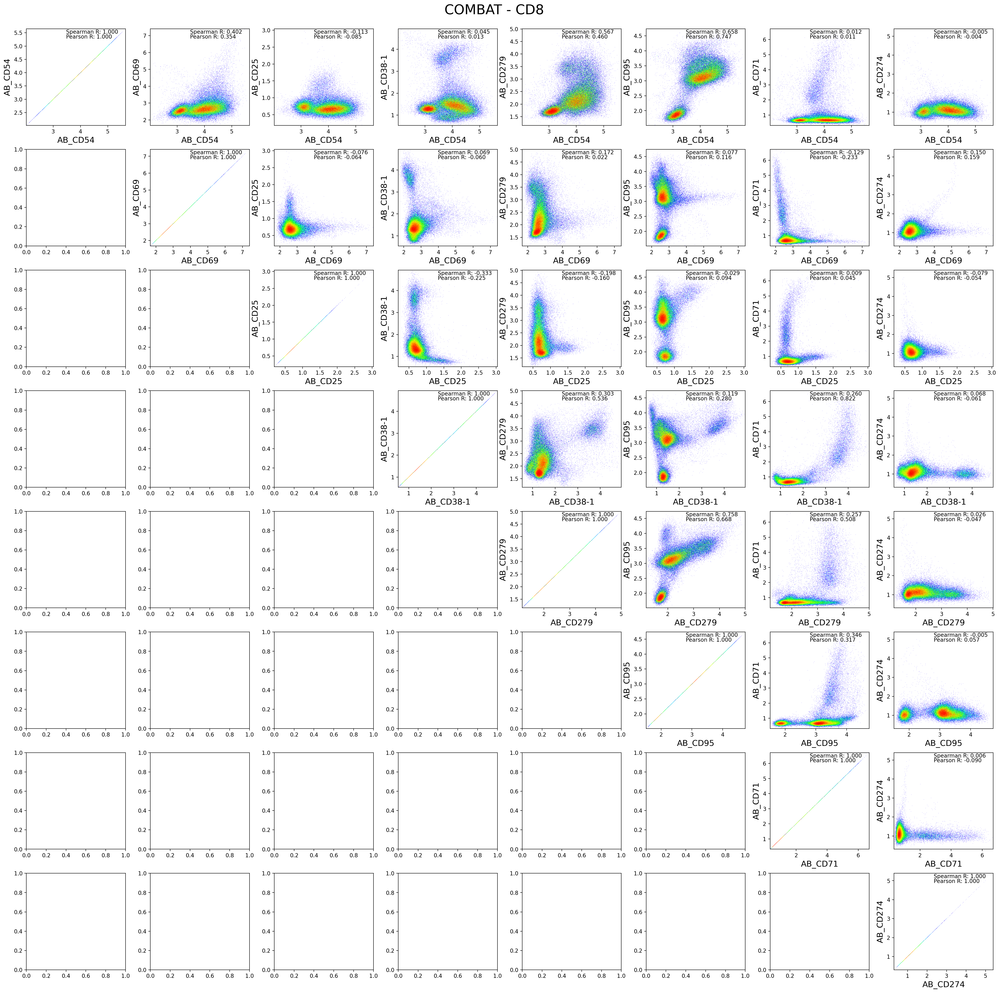

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


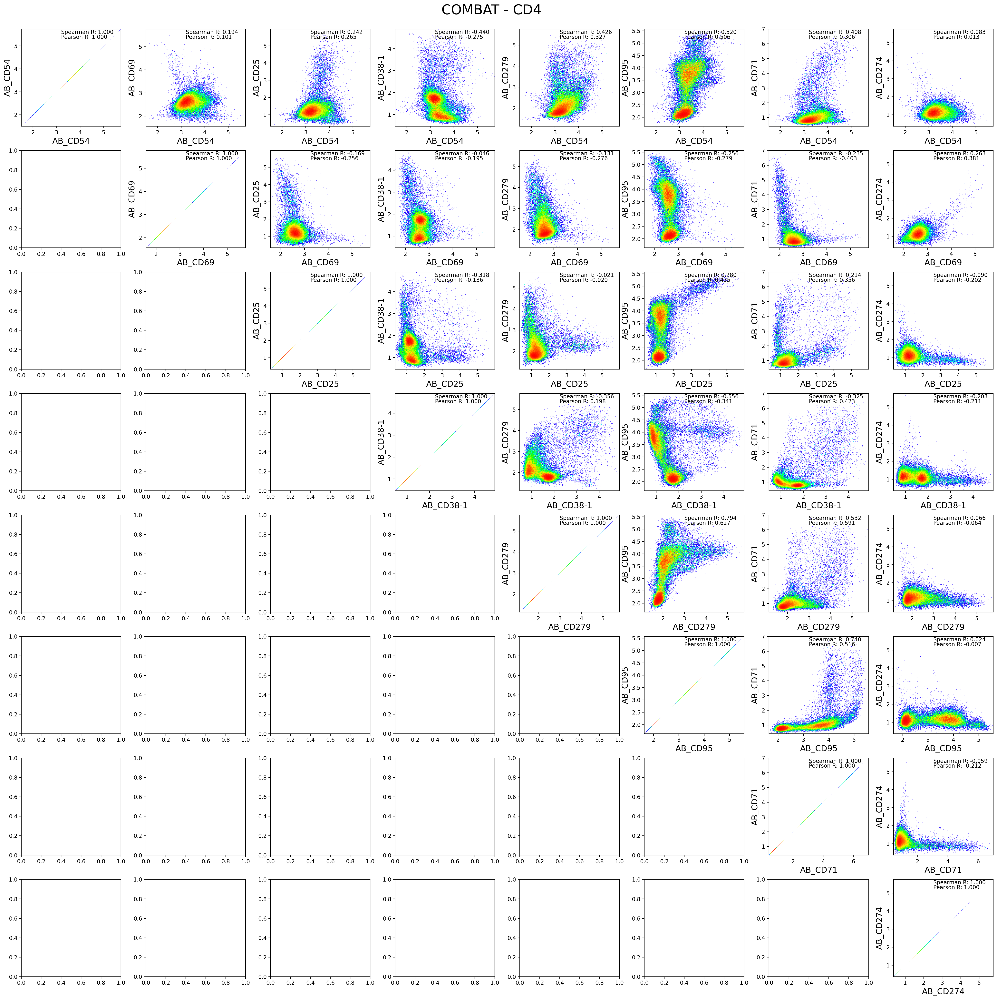

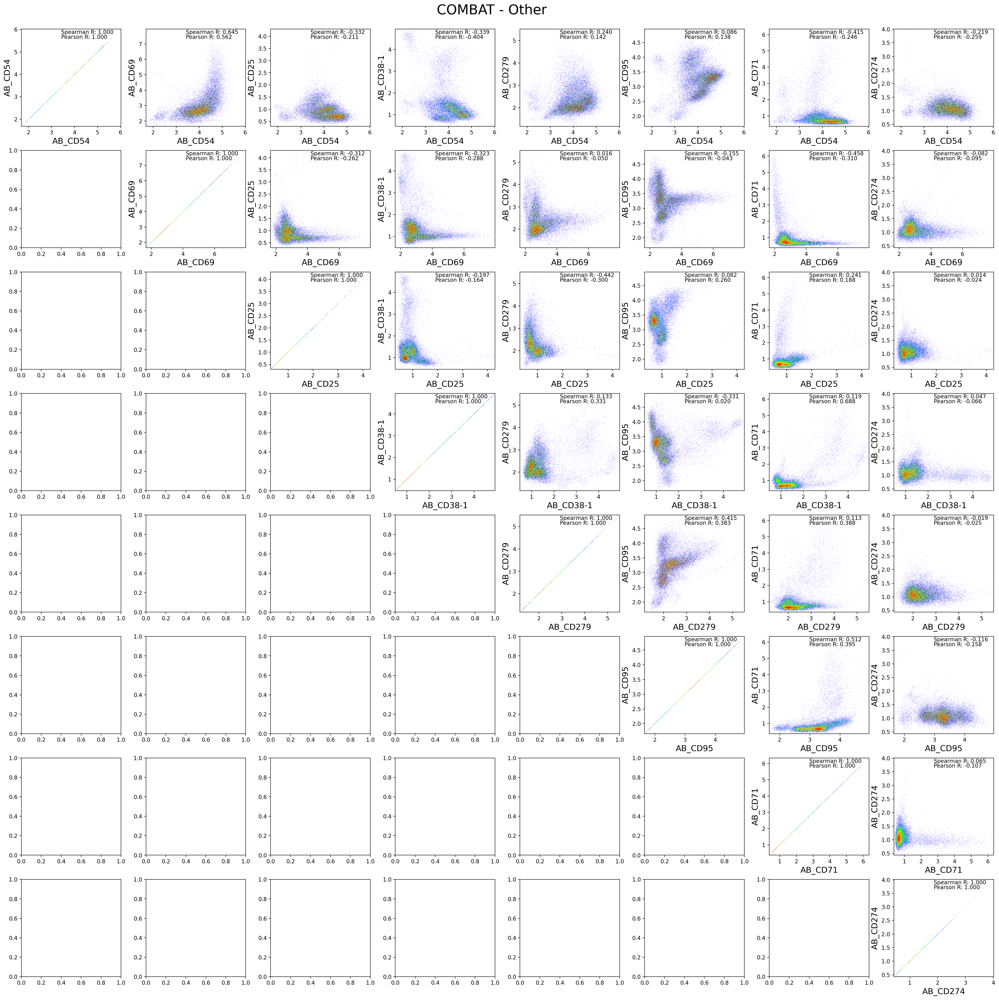

In [231]:
for lineage in lineage_gating['class'].unique():
    print(lineage)
    fontsize = 15
    nrows = len(markers_magic.columns)
    ncols = len(markers_magic.columns)
    fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(markers_magic.columns)),
                                                   nrows = nrows, ncols = ncols, 
                            gridspec_kw = {'wspace' : 0.25, 'hspace' : 0.25})
    
    ind = lineage_gating[lineage_gating['class']==lineage].index
    for i, p1 in enumerate(markers_magic.columns):
        # print(i, p1)
        # i = i-1

        for j, p2 in enumerate(markers_magic.columns):
            # j = j-1
            if j >= i:
                # print(j, p1)
                ax = axes[i, j]
                x = markers_magic.loc[ind, p1]
                y = markers_magic.loc[ind, p2]

                r_p, _ = pearsonr(x, y)
                r_s, _ = spearmanr(x, y)

                # ax.scatter(x, y)
                dsshow(pd.DataFrame({'x':x, 'y':y}), 
                       ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
                # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
                ax.text(x = .4, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 10, transform=ax.transAxes)
                ax.text(x = .4, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 10, transform=ax.transAxes)
                ax.set_xlabel(p1, fontsize = fontsize)
                ax.set_ylabel(p2, fontsize = fontsize)
    plt.suptitle('%s - %s' % (dataset, lineage), y = 0.9, fontsize = fontsize + 10)

In [233]:
gating = pd.DataFrame(index=markers_magic.index, columns=['Activated_CD8', 'Activated_CD4', 
                                                          'Activated_Other', 'Class'])
gating['Class'] = lineage_gating.loc[gating.index, 'class']

In [293]:
lineage = 'CD8'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [294]:
gating['Activated_CD8'].value_counts()

Unactivated    24647
Activated       2035
Name: Activated_CD8, dtype: int64

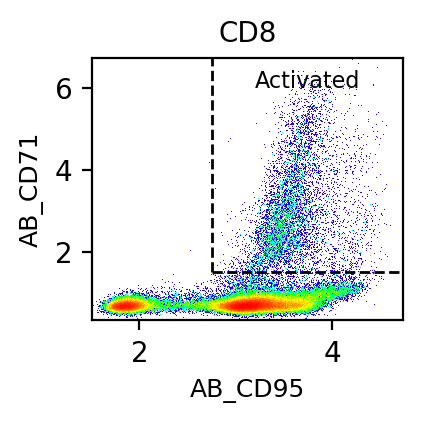

In [295]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
gating['Activated_CD8'], ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':1.5, 'hthresh':2.75, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3.2,6, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD8.png'))
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD8.pdf'))

In [297]:
gating['Activated_CD4'].value_counts()

Unactivated    254032
Activated       14853
Name: Activated_CD4, dtype: int64

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

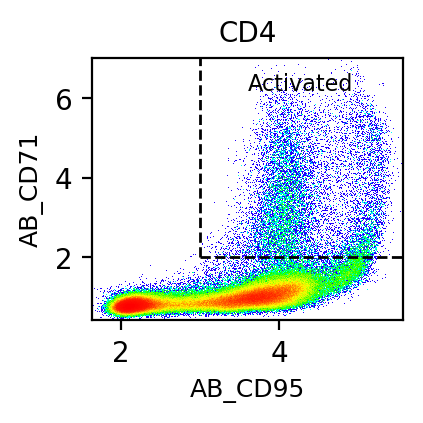

In [298]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
gating['Activated_CD4'], ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':2, 'hthresh':3, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3.6,6.2, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD4.png'))
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD4.pdf'))

In [299]:
lineage = 'Other'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [300]:
gating['Activated_Other'].value_counts()

Unactivated    24774
Activated       1908
Name: Activated_Other, dtype: int64

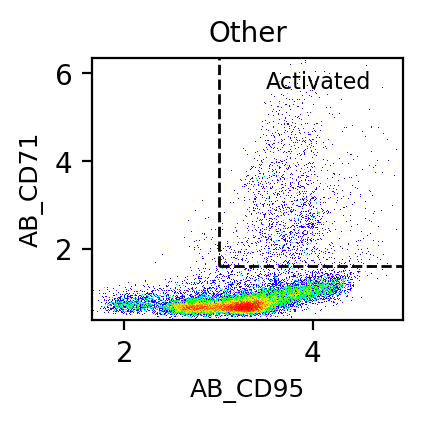

In [301]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
gating['Activated_Other'], ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':1.6, 'hthresh':3, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3.5,5.65, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_Other.png'))
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_Other.pdf'))

In [277]:
gating['Activated_Other'].value_counts()

Unactivated    24774
Activated       1908
Name: Activated_Other, dtype: int64

In [278]:
gating['Activated'] = np.nan

In [279]:
label = gating[['Activated_CD8', 'Activated_CD4', 'Activated_Other']].unstack().dropna().reset_index()
label.index = label['level_1']

In [280]:
gating.loc[label.index, 'Activated'] = label[0]

In [281]:
label.shape

(400925, 3)

In [282]:
len(label.index.unique())

400925

In [283]:
label.head()

,level_0,level_1,0
level_1,,,
AAACCTGAGCGGATCA-1-gPlexA1,Activated_CD8,AAACCTGAGCGGATCA-1-gPlexA1,Unactivated
AAACCTGTCACCGGGT-1-gPlexA1,Activated_CD8,AAACCTGTCACCGGGT-1-gPlexA1,Activated
AAACCTGTCGGTTCGG-1-gPlexA1,Activated_CD8,AAACCTGTCGGTTCGG-1-gPlexA1,Unactivated
AAACGGGAGAAGGGTA-1-gPlexA1,Activated_CD8,AAACGGGAGAAGGGTA-1-gPlexA1,Unactivated
AAACGGGAGACTAGGC-1-gPlexA1,Activated_CD8,AAACGGGAGACTAGGC-1-gPlexA1,Unactivated


In [284]:
(gating.isna().sum(axis = 1)==2).value_counts()

True    400925
dtype: int64

In [285]:
gating

,Activated_CD8,Activated_CD4,Activated_Other,Class,Activated
AAACCTGAGCGGATCA-1-gPlexA1,Unactivated,NaN,NaN,CD8,Unactivated
AAACCTGCAGCTCGAC-1-gPlexA1,NaN,Unactivated,NaN,CD4,Unactivated
AAACCTGCATCTATGG-1-gPlexA1,NaN,Unactivated,NaN,CD4,Unactivated
AAACCTGGTCTCTCTG-1-gPlexA1,NaN,Unactivated,NaN,CD4,Unactivated
AAACCTGTCACCGGGT-1-gPlexA1,Activated,NaN,NaN,CD8,Activated
...,...,...,...,...,...
TTTGGTTTCCTCAACC-1-gPlexK7,NaN,Unactivated,NaN,CD4,Unactivated
TTTGGTTTCTCGATGA-1-gPlexK7,NaN,Unactivated,NaN,CD4,Unactivated
TTTGTCACACCACGTG-1-gPlexK7,Unactivated,NaN,NaN,CD8,Unactivated
TTTGTCAGTTACCGAT-1-gPlexK7,Unactivated,NaN,NaN,CD8,Unactivated


In [286]:
gating['Activated'].value_counts()

Unactivated    376545
Activated       24380
Name: Activated, dtype: int64

In [287]:
gating[['Class', 'Activated']].value_counts()

Class  Activated  
CD4    Unactivated    254032
CD8    Unactivated     97739
Other  Unactivated     24774
CD4    Activated       14853
CD8    Activated        7619
Other  Activated        1908
dtype: int64

In [288]:
outfn = os.path.join(outdir, 'ManualGatingActivationByLineage.Magic.20230112.tsv')
print(outfn)

../../../Data/PerDataset/COMBAT/ManualGatingActivationByLineage.Magic.20230112.tsv


In [289]:
gating[['Class', 'Activated']].to_csv(outfn, sep='\t')

## By lineage classes (CD4 Conv, CD4 Treg, CD8 Conv, Other)

In [14]:
lineage_gating = pd.read_csv(params.loc[dataset, 'manual_gating_fn'], index_col = 0, sep = '\t')
lineage_gating.columns = ['gating']

lineage_gating['class'] = np.nan
lineage_gating.loc[lineage_gating['gating'].str.contains('CD4'), 'class'] = 'CD4 Conv'
lineage_gating.loc[lineage_gating['gating']=='Treg', 'class'] = 'CD4 Treg'
lineage_gating.loc[lineage_gating['gating'].str.contains('CD8'), 'class'] = 'CD8 Conv'
lineage_gating.loc[lineage_gating['class'].isna(), 'class'] = 'Other'

In [10]:
lineage_gating.value_counts()

gating     class   
CD4_Naive  CD4 Conv    116069
CD4_CM     CD4 Conv     98734
CD4_EM     CD4 Conv     41164
CD8_TEMRA  CD8 Conv     36847
CD8_EM     CD8 Conv     33279
CD8_Naive  CD8 Conv     25526
DP         Other        13044
Treg       CD4 Treg     11798
CD8_CM     CD8 Conv      9706
gdT        Other         6204
MAIT       Other         6048
DN         Other         1386
CD4_TEMRA  CD4 Conv      1120
dtype: int64

In [11]:
lineage_gating['class'].value_counts()

CD4 Conv    257087
CD8 Conv    105358
Other        26682
CD4 Treg     11798
Name: class, dtype: int64

CD8 Conv
CD4 Conv
Other
CD4 Treg


findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warni

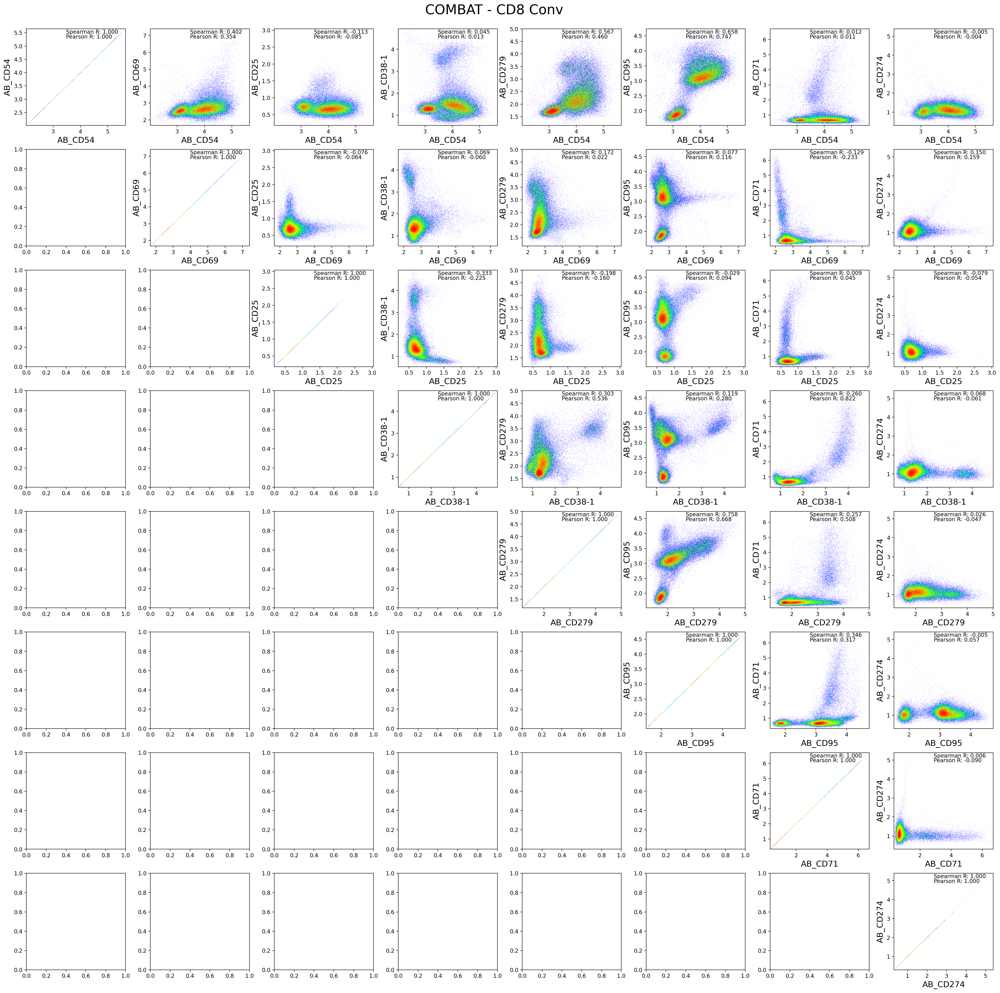

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

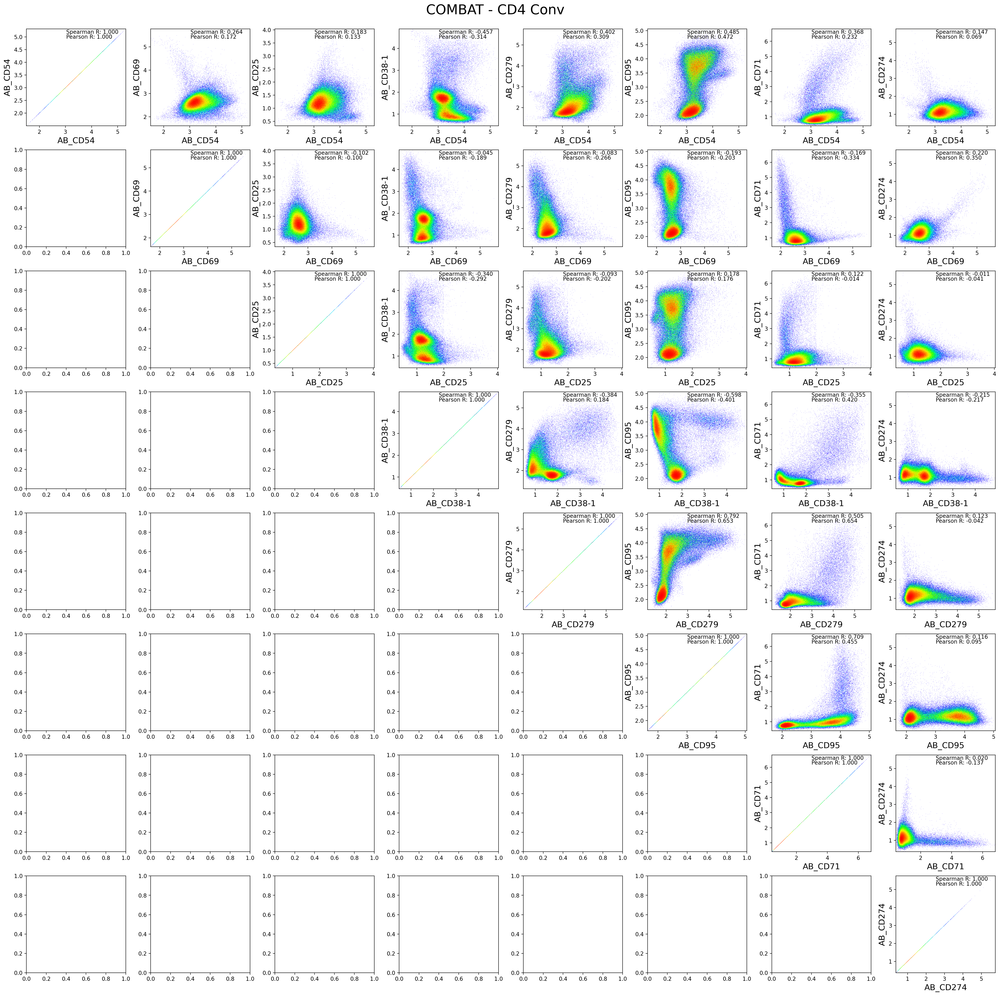

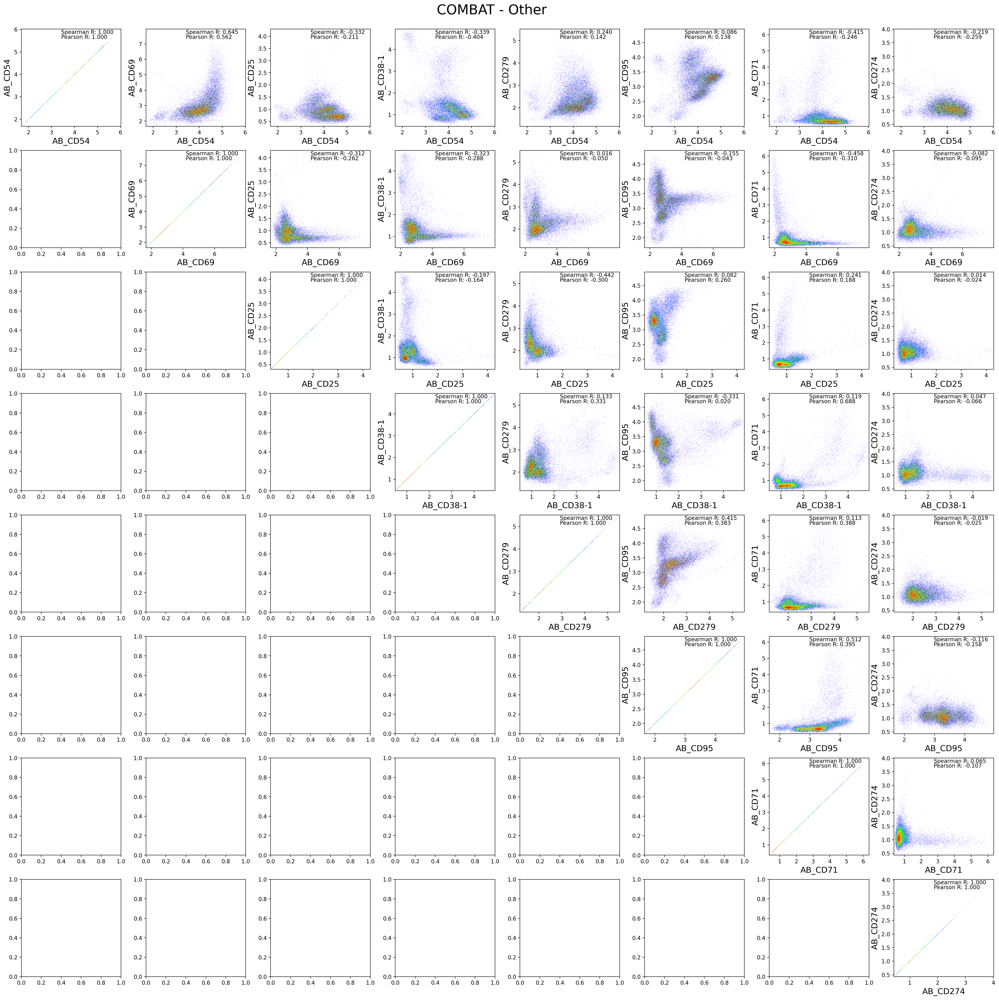

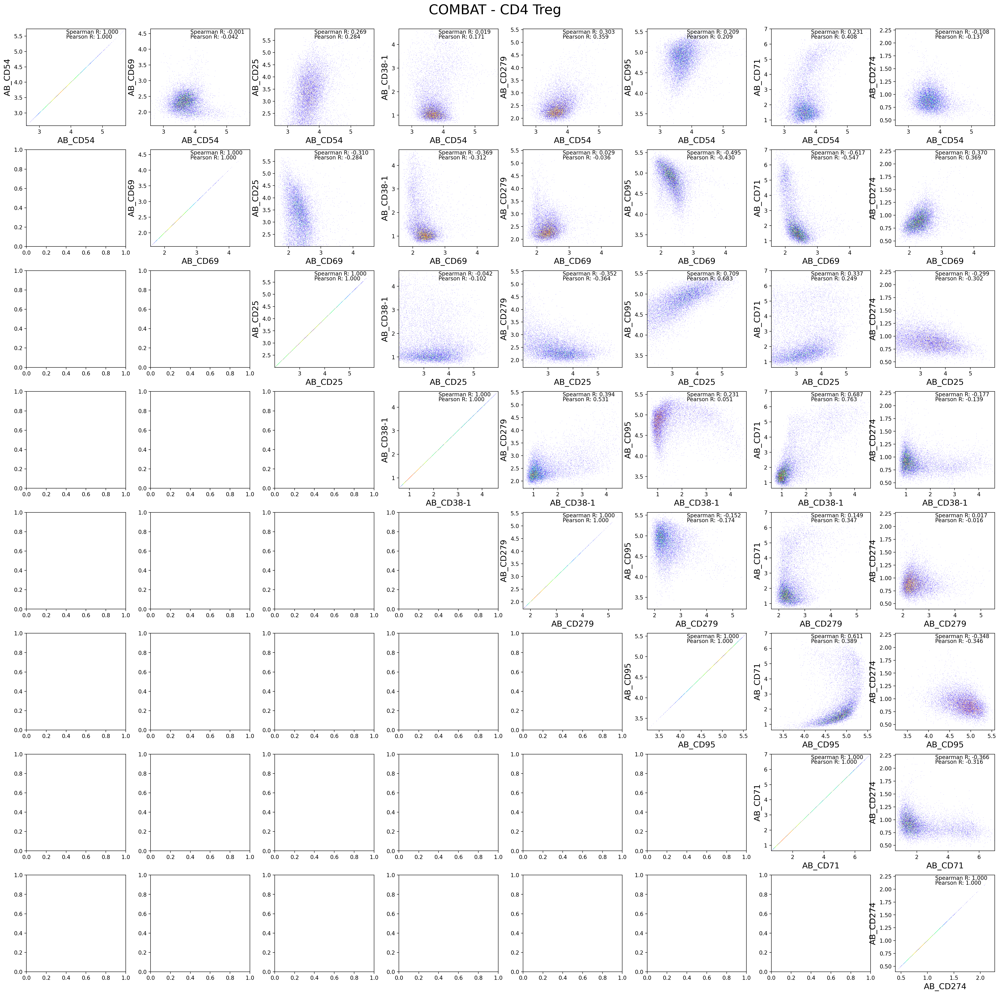

In [32]:
for lineage in lineage_gating['class'].unique():
    print(lineage)
    fontsize = 15
    nrows = len(markers_magic.columns)
    ncols = len(markers_magic.columns)
    fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(markers_magic.columns)),
                                                   nrows = nrows, ncols = ncols, 
                            gridspec_kw = {'wspace' : 0.25, 'hspace' : 0.25})
    
    ind = lineage_gating[lineage_gating['class']==lineage].index
    for i, p1 in enumerate(markers_magic.columns):
        # print(i, p1)
        # i = i-1

        for j, p2 in enumerate(markers_magic.columns):
            # j = j-1
            if j >= i:
                # print(j, p1)
                ax = axes[i, j]
                x = markers_magic.loc[ind, p1]
                y = markers_magic.loc[ind, p2]

                r_p, _ = pearsonr(x, y)
                r_s, _ = spearmanr(x, y)

                # ax.scatter(x, y)
                dsshow(pd.DataFrame({'x':x, 'y':y}), 
                       ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
                # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
                ax.text(x = .4, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 10, transform=ax.transAxes)
                ax.text(x = .4, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 10, transform=ax.transAxes)
                ax.set_xlabel(p1, fontsize = fontsize)
                ax.set_ylabel(p2, fontsize = fontsize)
    plt.suptitle('%s - %s' % (dataset, lineage), y = 0.9, fontsize = fontsize + 10)

In [ ]:
# gating = pd.DataFrame(index=markers_magic.index, columns=['Activated_CD8', 'Activated_CD4', 
#                                                           'Activated_Other', 'Class'])
# gating['Class'] = lineage_gating.loc[gating.index, 'class']

Change plots to show CD4 Convs and CD4 Tregs separately, but don't change thresholds

In [18]:
lineage = 'CD8 Conv'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [ ]:
ind.value_counts()

False    295567
True     105358
Name: class, dtype: int64

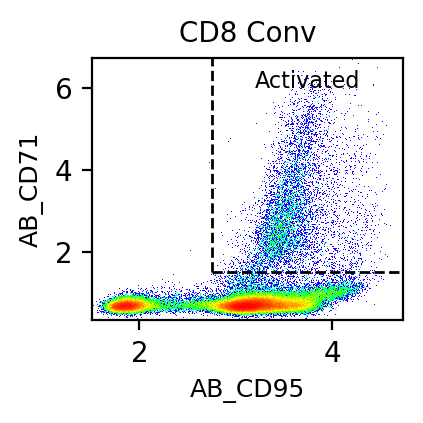

In [37]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
_, ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':1.5, 'hthresh':2.75, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3.2,6, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD8Conv.png'))
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD8Conv.pdf'))

In [ ]:
gating['Activated_CD4'].value_counts()

In [34]:
lineage = 'CD4 Conv'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

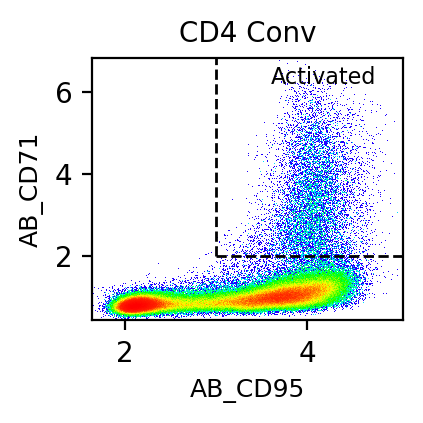

In [35]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
_, ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':2, 'hthresh':3, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3.6,6.2, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)

xlims = ax.get_xlim()

plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD4Conv.png'))
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD4Conv.pdf'))



In [27]:
xlims[0]

1.6385513096656106

In [32]:
lineage = 'CD4 Treg'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

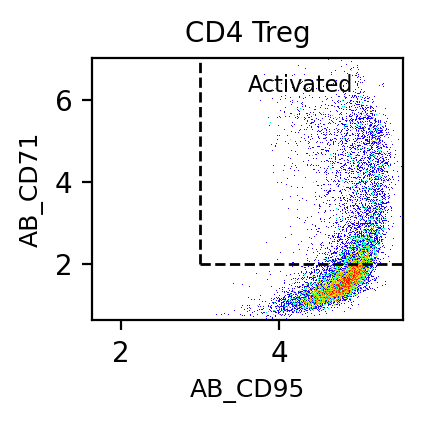

In [33]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
_, ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':2, 'hthresh':3, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3.6,6.2, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
ax.set_xlim(left = xlims[0])
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD4Treg.png'))
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_CD4Treg.pdf'))



In [30]:
lineage = 'Other'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [ ]:
gating['Activated_Other'].value_counts()

Text(0.5, 1.0, 'Other')

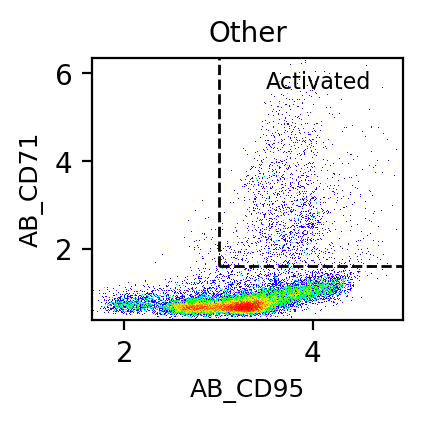

In [31]:
g1 = 'AB_CD95'
g2 = 'AB_CD71'   
_, ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':1.6, 'hthresh':3, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3.5,5.65, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
# plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_Other.png'))
# plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_Other.pdf'))

In [65]:
tick_fontsize = 7
label_fontsize = 8
title_fontsize = 9

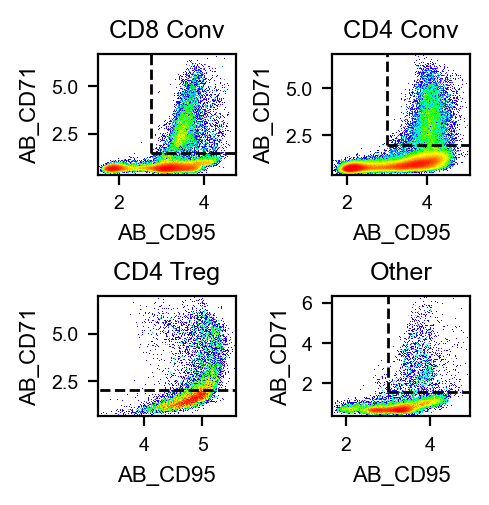

In [68]:
nrows = 2
ncols = 2
fig, axes = plt.subplots(dpi = 200, figsize = (2.4, 2.4), ncols = ncols, nrows = nrows,
                        gridspec_kw = {'wspace' : .7, 'hspace' : 1})

lineage = 'CD8 Conv'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage
g1 = 'AB_CD95'
g2 = 'AB_CD71'  
ax = axes[0, 0]
gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':1.5, 'hthresh':2.75, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True, ax  =ax)
# ax.text(3.2,6, 'Activated', fontsize=tick_fontsize)
ax.set_title(lineage, fontsize=title_fontsize)
ax.tick_params('both', labelsize = tick_fontsize)
ax.set_ylabel(ax.get_ylabel(), fontsize = label_fontsize)
ax.set_xlabel(ax.get_xlabel(), fontsize = label_fontsize)


lineage = 'CD4 Conv'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage
g1 = 'AB_CD95'
g2 = 'AB_CD71' 
ax = axes[0, 1]
gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':2, 'hthresh':3, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True, ax = ax)
# ax.text(3.6,6.2, 'Activated', fontsize=tick_fontsize)
ax.set_title(lineage, fontsize=title_fontsize)
ax.tick_params('both', labelsize = tick_fontsize)
ax.set_ylabel(ax.get_ylabel(), fontsize = label_fontsize)
ax.set_xlabel(ax.get_xlabel(), fontsize = label_fontsize)


lineage = 'CD4 Treg'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

g1 = 'AB_CD95'
g2 = 'AB_CD71'   
ax = axes[1, 0]
gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':2, 'hthresh':3, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True, ax = ax)
# ax.text(3.6,6.2, 'Activated', fontsize=tick_fontsize)
ax.set_title(lineage, fontsize=title_fontsize)
ax.tick_params('both', labelsize = tick_fontsize)
# ax.set_xlim(left = xlims[0])
ax.set_ylabel(ax.get_ylabel(), fontsize = label_fontsize)
ax.set_xlabel(ax.get_xlabel(), fontsize = label_fontsize)


lineage = 'Other'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage
g1 = 'AB_CD95'
g2 = 'AB_CD71'  
ax = axes[1, 1]
gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':1.6, 'hthresh':3, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True, ax = ax)
# ax.text(3.5,5.65, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=title_fontsize)
ax.tick_params('both', labelsize = tick_fontsize)
ax.set_ylabel(ax.get_ylabel(), fontsize = label_fontsize)
ax.set_xlabel(ax.get_xlabel(), fontsize = label_fontsize)
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_Merged.png'), bbox_inches="tight")
plt.savefig(os.path.join(figdir, 'ManualGatingActivation_COMBAT_Merged.pdf'), bbox_inches="tight")

# Cluster on non-smoothed markers by lineage

In [74]:
harmony_vars = ['Institute',  'COMBAT_participant_timepoint_ID'#'COMBAT_ID'
               ]

In [68]:
adata_ADT.obs.columns

Index(['Annotation_cluster_name', 'Annotation_minor_subset',
       'Annotation_major_subset', 'Annotation_cell_type', 'GEX_region',
       'QC_ngenes', 'QC_total_UMI', 'QC_pct_mitochondrial',
       'QC_scrub_doublet_scores', 'TCR_chain_composition', 'TCR_clone_ID',
       'TCR_clone_count', 'TCR_clone_proportion', 'TCR_contains_unproductive',
       'TCR_doublet', 'TCR_chain_TRA', 'TCR_v_gene_TRA', 'TCR_d_gene_TRA',
       'TCR_j_gene_TRA', 'TCR_c_gene_TRA', 'TCR_productive_TRA',
       'TCR_cdr3_TRA', 'TCR_umis_TRA', 'TCR_chain_TRA2', 'TCR_v_gene_TRA2',
       'TCR_d_gene_TRA2', 'TCR_j_gene_TRA2', 'TCR_c_gene_TRA2',
       'TCR_productive_TRA2', 'TCR_cdr3_TRA2', 'TCR_umis_TRA2',
       'TCR_chain_TRB', 'TCR_v_gene_TRB', 'TCR_d_gene_TRB', 'TCR_j_gene_TRB',
       'TCR_c_gene_TRB', 'TCR_productive_TRB', 'TCR_chain_TRB2',
       'TCR_v_gene_TRB2', 'TCR_d_gene_TRB2', 'TCR_j_gene_TRB2',
       'TCR_c_gene_TRB2', 'TCR_productive_TRB2', 'TCR_cdr3_TRB2',
       'TCR_umis_TRB2', 'COMBAT_ID',

In [43]:
# adt_markers = ['AB_CD25','AB_CD38-1', 'AB_CD279', 'AB_CD54', 'AB_CD69', 'AB_CD71', 'AB_CD274',
#               'AB_CD95']
adt_markers

['AB_CD25',
 'AB_CD38-1',
 'AB_CD279',
 'AB_CD54',
 'AB_CD69',
 'AB_CD71',
 'AB_CD274',
 'AB_CD95']

In [29]:
lineage_gating = pd.read_csv(params.loc[dataset, 'manual_gating_fn'], index_col = 0, sep = '\t')
lineage_gating.columns = ['gating']

lineage_gating['class'] = np.nan
lineage_gating.loc[lineage_gating['gating'].str.contains('CD4'), 'class'] = 'CD4 Conv'
lineage_gating.loc[lineage_gating['gating']=='Treg', 'class'] = 'CD4 Treg'
lineage_gating.loc[lineage_gating['gating'].str.contains('CD8'), 'class'] = 'CD8 Conv'
lineage_gating.loc[lineage_gating['class'].isna(), 'class'] = 'Other'

Do 3 ways:
1. Cluster all cells at once
2. Cluster 3x (CD4, CD8, Other)
3. Harmonize over lineage

## All cells

In [44]:
adata_ADT_filt = adata_ADT[:, adt_markers].copy()

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial


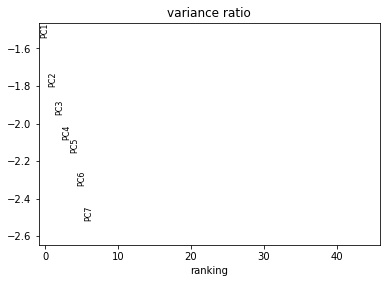

In [45]:
sc.tl.pca(adata_ADT_filt, zero_center=True)
sc.pl.pca_variance_ratio(adata_ADT_filt, log=True, n_pcs=45)

In [46]:
adata_ADT_filt.obsm['X_pca'].shape

(400925, 7)

In [47]:
adata_ADT_filt.obs[harmony_vars] = adata_ADT_filt.obs[harmony_vars].astype(str)

In [48]:
adata_ADT_filt.obs[harmony_vars]

,Institute,COMBAT_participant_timepoint_ID
AAACCTGAGCGGATCA-1-gPlexA1,Oxford,S00112-Ja003
AAACCTGCAGCTCGAC-1-gPlexA1,Oxford,S00005-Ja005
AAACCTGCATCTATGG-1-gPlexA1,Oxford,H00067-Ha001
AAACCTGGTCTCTCTG-1-gPlexA1,Oxford,N00027-Ja001
AAACCTGTCACCGGGT-1-gPlexA1,St_Georges,U00515-Ua005
...,...,...
TTTGGTTTCCTCAACC-1-gPlexK7,Oxford,S00048-Ja003
TTTGGTTTCTCGATGA-1-gPlexK7,Oxford,N00038-Ja001
TTTGTCACACCACGTG-1-gPlexK7,Oxford,S00057-Ja003
TTTGTCAGTTACCGAT-1-gPlexK7,St_Georges,U00501-Ua005


In [ ]:
sc.external.pp.harmony_integrate(adata_ADT_filt,  harmony_vars, max_iter_harmony = 30)

In [ ]:
sc.pp.neighbors(adata_ADT_filt, n_neighbors=10, n_pcs=6, use_rep='X_pca_harmony')
sc.tl.umap(adata_ADT_filt)
adata_ADT_filt.obsm['X_ADT_UMAP'] = adata_ADT_filt.obsm['X_umap']
for res in np.arange(0.2, 1.2, 0.2):
    print(res)
    sc.tl.leiden(adata_ADT_filt, resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))

In [ ]:
adata_ADT_filt.obs.columns[adata_ADT_filt.obs.columns.str.contains('leiden')]

In [ ]:
sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', 
                color = adata_ADT_filt.obs.columns[adata_ADT_filt.obs.columns.str.contains('leiden')])


In [ ]:
sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', color = adt_markers)

In [ ]:
sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', color = 'Sort_Status')

In [ ]:
act_clusters_all['All_Cells'] = ('leiden_0_20', ['0'])

In [ ]:
adata_ADT_filt.obsm['X_umap']

In [ ]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_All.h5ad')
print(outfn)

In [ ]:
sc.write(filename = outfn, adata = adata_ADT_filt)

In [ ]:
# sc.pp.neighbors(adata_ADT_filt, n_neighbors=10, n_pcs=6, use_rep='X_pca')
# sc.tl.umap(adata_ADT_filt)
# adata_ADT_filt.obsm['X_ADT_UMAP'] = adata_ADT_filt.obsm['X_umap']
# for res in np.arange(0.2, 1.2, 0.2):
#     print(res)
#     sc.tl.leiden(adata_ADT_filt, resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))

# adata_ADT_filt.obs.columns[adata_ADT_filt.obs.columns.str.contains('leiden')]

# sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', 
#                 color = adata_ADT_filt.obs.columns[adata_ADT_filt.obs.columns.str.contains('leiden')])


# sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', color = adt_markers)

## By lineage classes (CD4 Conv, CD4 Treg, CD8 Conv, Other)

In [13]:
adata_lineages = {}

In [52]:
lineage_gating['class'].unique()

array(['CD8 Conv', 'CD4 Conv', 'Other', 'CD4 Treg'], dtype=object)

In [58]:
harmony_vars

['Institute', 'COMBAT_participant_timepoint_ID']

In [63]:
adata_lineages['CD4 Treg']

AnnData object with n_obs × n_vars = 11798 × 8
    obs: 'Annotation_cluster_name', 'Annotation_minor_subset', 'Annotation_major_subset', 'Annotation_cell_type', 'GEX_region', 'QC_ngenes', 'QC_total_UMI', 'QC_pct_mitochondrial', 'QC_scrub_doublet_scores', 'TCR_chain_composition', 'TCR_clone_ID', 'TCR_clone_count', 'TCR_clone_proportion', 'TCR_contains_unproductive', 'TCR_doublet', 'TCR_chain_TRA', 'TCR_v_gene_TRA', 'TCR_d_gene_TRA', 'TCR_j_gene_TRA', 'TCR_c_gene_TRA', 'TCR_productive_TRA', 'TCR_cdr3_TRA', 'TCR_umis_TRA', 'TCR_chain_TRA2', 'TCR_v_gene_TRA2', 'TCR_d_gene_TRA2', 'TCR_j_gene_TRA2', 'TCR_c_gene_TRA2', 'TCR_productive_TRA2', 'TCR_cdr3_TRA2', 'TCR_umis_TRA2', 'TCR_chain_TRB', 'TCR_v_gene_TRB', 'TCR_d_gene_TRB', 'TCR_j_gene_TRB', 'TCR_c_gene_TRB', 'TCR_productive_TRB', 'TCR_chain_TRB2', 'TCR_v_gene_TRB2', 'TCR_d_gene_TRB2', 'TCR_j_gene_TRB2', 'TCR_c_gene_TRB2', 'TCR_productive_TRB2', 'TCR_cdr3_TRB2', 'TCR_umis_TRB2', 'COMBAT_ID', 'scRNASeq_sample_ID', 'COMBAT_participant_timepo

CD4 Treg


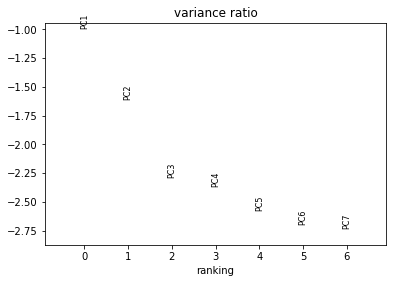

2024-02-14 15:57:33,233 - harmonypy - INFO - Iteration 1 of 30
2024-02-14 15:57:45,370 - harmonypy - INFO - Iteration 2 of 30
2024-02-14 15:57:56,191 - harmonypy - INFO - Iteration 3 of 30
2024-02-14 15:58:07,790 - harmonypy - INFO - Iteration 4 of 30
2024-02-14 15:58:17,674 - harmonypy - INFO - Iteration 5 of 30
2024-02-14 15:58:28,541 - harmonypy - INFO - Iteration 6 of 30
2024-02-14 15:58:38,204 - harmonypy - INFO - Iteration 7 of 30
2024-02-14 15:58:47,797 - harmonypy - INFO - Iteration 8 of 30
2024-02-14 15:58:57,269 - harmonypy - INFO - Iteration 9 of 30
2024-02-14 15:59:03,949 - harmonypy - INFO - Iteration 10 of 30
2024-02-14 15:59:11,768 - harmonypy - INFO - Iteration 11 of 30
2024-02-14 15:59:21,561 - harmonypy - INFO - Iteration 12 of 30
2024-02-14 15:59:29,774 - harmonypy - INFO - Iteration 13 of 30
2024-02-14 15:59:39,794 - harmonypy - INFO - Iteration 14 of 30
2024-02-14 15:59:47,846 - harmonypy - INFO - Iteration 15 of 30
2024-02-14 15:59:56,039 - harmonypy - INFO - Iter

0.2
0.4
0.6000000000000001
0.8
1.0


In [70]:
for lineage in ['CD4 Treg']: #lineage_gating['class'].unique():
    print(lineage)
    
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
    adata_lineages[lineage] = adata_ADT[ind_lineage, adt_markers].copy()
    
    sc.tl.pca(adata_lineages[lineage], zero_center=True)
    sc.pl.pca_variance_ratio(adata_lineages[lineage], log=True, n_pcs=6)

    adata_lineages[lineage].obs[harmony_vars] = adata_lineages[lineage].obs[harmony_vars].astype(str)
    sc.external.pp.harmony_integrate(adata_lineages[lineage],  harmony_vars, max_iter_harmony = 30)

    sc.pp.neighbors(adata_lineages[lineage], n_neighbors=10, n_pcs=6, use_rep='X_pca_harmony')
    sc.tl.umap(adata_lineages[lineage])
    adata_lineages[lineage].obsm['X_ADT_UMAP'] = adata_lineages[lineage].obsm['X_umap']
    for res in np.arange(0.2, 1.2, 0.2):
        print(res)
        sc.tl.leiden(adata_lineages[lineage], resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))
        
    

In [100]:
sc.external.pp.harmony_integrate(adata_lineages[lineage],  harmony_vars, max_iter_harmony = 30, 
                                 nclust = 10)

sc.pp.neighbors(adata_lineages[lineage], n_neighbors=10, n_pcs=6, use_rep='X_pca_harmony')
sc.tl.umap(adata_lineages[lineage])


adata_lineages[lineage].obsm['X_ADT_UMAP'] = adata_lineages[lineage].obsm['X_umap']


2024-02-14 16:23:07,640 - harmonypy - INFO - Iteration 1 of 30
2024-02-14 16:23:09,536 - harmonypy - INFO - Iteration 2 of 30
2024-02-14 16:23:11,101 - harmonypy - INFO - Iteration 3 of 30
2024-02-14 16:23:12,455 - harmonypy - INFO - Iteration 4 of 30
2024-02-14 16:23:13,885 - harmonypy - INFO - Iteration 5 of 30
2024-02-14 16:23:15,277 - harmonypy - INFO - Iteration 6 of 30
2024-02-14 16:23:16,412 - harmonypy - INFO - Iteration 7 of 30
2024-02-14 16:23:17,596 - harmonypy - INFO - Iteration 8 of 30
2024-02-14 16:23:18,994 - harmonypy - INFO - Iteration 9 of 30
2024-02-14 16:23:20,495 - harmonypy - INFO - Converged after 9 iterations


In [111]:
lineage_gating['class'].unique()

array(['CD8 Conv', 'CD4 Conv', 'Other', 'CD4 Treg'], dtype=object)

CD8 Conv


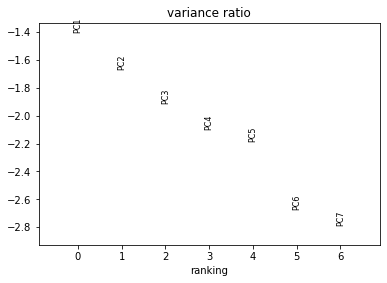

2024-02-14 16:25:54,338 - harmonypy - INFO - Iteration 1 of 30
2024-02-14 16:26:02,410 - harmonypy - INFO - Iteration 2 of 30
2024-02-14 16:26:12,782 - harmonypy - INFO - Iteration 3 of 30
2024-02-14 16:26:21,181 - harmonypy - INFO - Iteration 4 of 30
2024-02-14 16:26:28,358 - harmonypy - INFO - Iteration 5 of 30
2024-02-14 16:26:34,887 - harmonypy - INFO - Iteration 6 of 30
2024-02-14 16:26:41,544 - harmonypy - INFO - Iteration 7 of 30
2024-02-14 16:26:48,507 - harmonypy - INFO - Iteration 8 of 30
2024-02-14 16:26:56,457 - harmonypy - INFO - Iteration 9 of 30
2024-02-14 16:27:03,837 - harmonypy - INFO - Converged after 9 iterations


0.2
0.4
0.6000000000000001
0.8
1.0
CD4 Conv


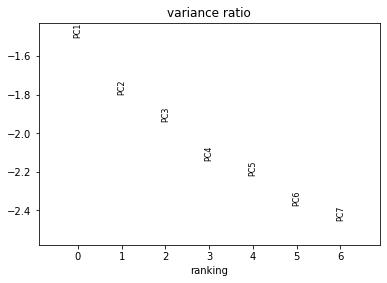

2024-02-14 16:31:40,939 - harmonypy - INFO - Iteration 1 of 30
2024-02-14 16:32:04,359 - harmonypy - INFO - Iteration 2 of 30
2024-02-14 16:32:35,175 - harmonypy - INFO - Iteration 3 of 30
2024-02-14 16:33:04,626 - harmonypy - INFO - Iteration 4 of 30
2024-02-14 16:33:27,681 - harmonypy - INFO - Iteration 5 of 30
2024-02-14 16:33:49,762 - harmonypy - INFO - Iteration 6 of 30
2024-02-14 16:34:10,007 - harmonypy - INFO - Iteration 7 of 30
2024-02-14 16:34:30,848 - harmonypy - INFO - Iteration 8 of 30
2024-02-14 16:34:49,871 - harmonypy - INFO - Iteration 9 of 30
2024-02-14 16:35:09,192 - harmonypy - INFO - Converged after 9 iterations


0.2
0.4
0.6000000000000001
0.8
1.0
Other


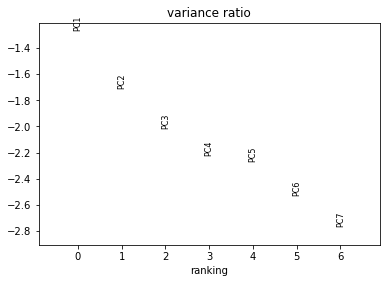

2024-02-14 16:56:56,691 - harmonypy - INFO - Iteration 1 of 30
2024-02-14 16:57:00,151 - harmonypy - INFO - Iteration 2 of 30
2024-02-14 16:57:03,546 - harmonypy - INFO - Iteration 3 of 30
2024-02-14 16:57:06,212 - harmonypy - INFO - Iteration 4 of 30
2024-02-14 16:57:09,140 - harmonypy - INFO - Iteration 5 of 30
2024-02-14 16:57:11,714 - harmonypy - INFO - Iteration 6 of 30
2024-02-14 16:57:14,139 - harmonypy - INFO - Iteration 7 of 30
2024-02-14 16:57:16,728 - harmonypy - INFO - Iteration 8 of 30
2024-02-14 16:57:18,963 - harmonypy - INFO - Iteration 9 of 30
2024-02-14 16:57:20,985 - harmonypy - INFO - Converged after 9 iterations


0.2
0.4
0.6000000000000001
0.8
1.0


In [113]:
# nclust = 10
for lineage in ['CD4 Treg', 'Other']: #lineage_gating['class'].unique():
    print(lineage)
    
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
    adata_lineages[lineage] = adata_ADT[ind_lineage, adt_markers].copy()
    
    sc.tl.pca(adata_lineages[lineage], zero_center=True)
    sc.pl.pca_variance_ratio(adata_lineages[lineage], log=True, n_pcs=6)

    adata_lineages[lineage].obs[harmony_vars] = adata_lineages[lineage].obs[harmony_vars].astype(str)
    sc.external.pp.harmony_integrate(adata_lineages[lineage],  harmony_vars, max_iter_harmony = 30,
                                    nclust = 10)

    sc.pp.neighbors(adata_lineages[lineage], n_neighbors=10, n_pcs=6, use_rep='X_pca_harmony')
    sc.tl.umap(adata_lineages[lineage])
    adata_lineages[lineage].obsm['X_ADT_UMAP'] = adata_lineages[lineage].obsm['X_umap']
    for res in np.arange(0.2, 1.2, 0.2):
        print(res)
        sc.tl.leiden(adata_lineages[lineage], resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))
        
    

CD8 Conv


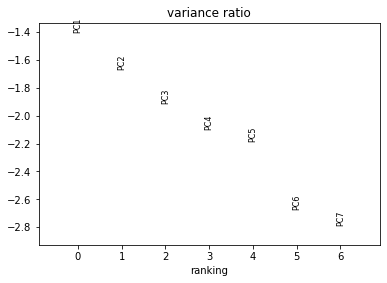

2024-02-14 17:35:15,592 - harmonypy - INFO - Iteration 1 of 30
2024-02-14 17:36:56,972 - harmonypy - INFO - Iteration 2 of 30
2024-02-14 17:38:56,428 - harmonypy - INFO - Iteration 3 of 30
2024-02-14 17:41:10,372 - harmonypy - INFO - Iteration 4 of 30
2024-02-14 17:43:18,465 - harmonypy - INFO - Iteration 5 of 30
2024-02-14 17:45:42,577 - harmonypy - INFO - Iteration 6 of 30
2024-02-14 17:48:24,662 - harmonypy - INFO - Iteration 7 of 30
2024-02-14 17:51:48,615 - harmonypy - INFO - Iteration 8 of 30
2024-02-14 17:55:41,381 - harmonypy - INFO - Iteration 9 of 30
2024-02-14 17:59:23,083 - harmonypy - INFO - Iteration 10 of 30
2024-02-14 18:03:18,424 - harmonypy - INFO - Iteration 11 of 30
2024-02-14 18:06:52,529 - harmonypy - INFO - Iteration 12 of 30
2024-02-14 18:09:59,361 - harmonypy - INFO - Iteration 13 of 30
2024-02-14 18:12:44,892 - harmonypy - INFO - Iteration 14 of 30
2024-02-14 18:14:58,886 - harmonypy - INFO - Iteration 15 of 30
2024-02-14 18:16:54,642 - harmonypy - INFO - Iter

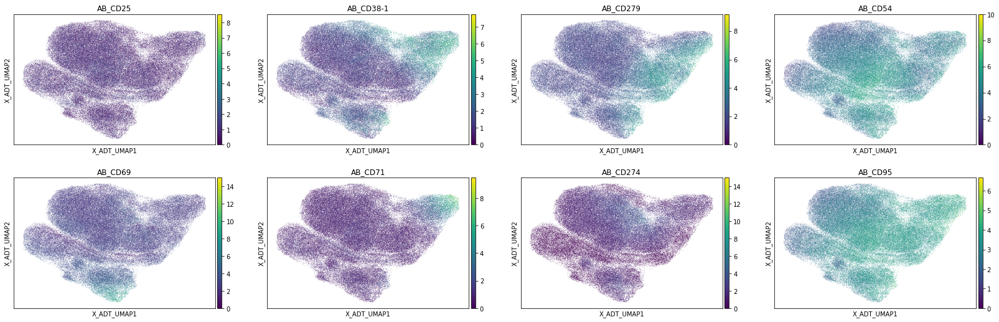

CD4 Conv


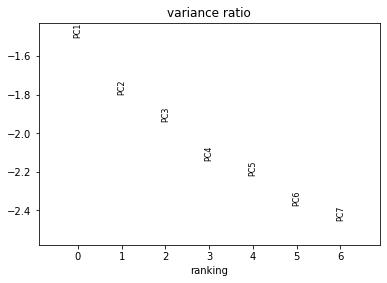

2024-02-14 18:38:32,803 - harmonypy - INFO - Iteration 1 of 30
2024-02-14 18:43:15,077 - harmonypy - INFO - Iteration 2 of 30
2024-02-14 18:48:04,472 - harmonypy - INFO - Iteration 3 of 30
2024-02-14 18:52:23,647 - harmonypy - INFO - Iteration 4 of 30
2024-02-14 18:55:47,443 - harmonypy - INFO - Iteration 5 of 30
2024-02-14 18:58:48,883 - harmonypy - INFO - Iteration 6 of 30
2024-02-14 19:01:30,374 - harmonypy - INFO - Iteration 7 of 30
2024-02-14 19:04:03,304 - harmonypy - INFO - Iteration 8 of 30
2024-02-14 19:06:50,822 - harmonypy - INFO - Iteration 9 of 30
2024-02-14 19:09:29,232 - harmonypy - INFO - Iteration 10 of 30
2024-02-14 19:11:30,867 - harmonypy - INFO - Iteration 11 of 30
2024-02-14 19:13:30,451 - harmonypy - INFO - Iteration 12 of 30
2024-02-14 19:15:38,407 - harmonypy - INFO - Iteration 13 of 30
2024-02-14 19:19:53,688 - harmonypy - INFO - Iteration 15 of 30
2024-02-14 19:21:58,689 - harmonypy - INFO - Iteration 16 of 30
2024-02-14 19:24:02,653 - harmonypy - INFO - Iter

In [ ]:
# nclust = 100
for lineage in ['CD8 Conv', 'CD4 Conv']: #lineage_gating['class'].unique():
    print(lineage)
    
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
    adata_lineages[lineage] = adata_ADT[ind_lineage, adt_markers].copy()
    
    sc.tl.pca(adata_lineages[lineage], zero_center=True)
    sc.pl.pca_variance_ratio(adata_lineages[lineage], log=True, n_pcs=6)

    adata_lineages[lineage].obs[harmony_vars] = adata_lineages[lineage].obs[harmony_vars].astype(str)
    sc.external.pp.harmony_integrate(adata_lineages[lineage],  harmony_vars, max_iter_harmony = 30,
                                    # nclust = 10
                                    )

    sc.pp.neighbors(adata_lineages[lineage], n_neighbors=10, n_pcs=6, use_rep='X_pca_harmony')
    sc.tl.umap(adata_lineages[lineage])
    adata_lineages[lineage].obsm['X_ADT_UMAP'] = adata_lineages[lineage].obsm['X_umap']
    
    sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)
    for res in np.arange(0.2, 1.2, 0.2):
        print(res)
        sc.tl.leiden(adata_lineages[lineage], resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))
        
    

In [136]:
for lineage in ['CD8 Conv', 'CD4 Conv']: #lineage_gating['class'].unique():
    print(lineage)
    for res in np.arange(0.2, 1.2, 0.2):
        print(res)
        sc.tl.leiden(adata_lineages[lineage], resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))


CD8 Conv
0.2
0.4
0.6000000000000001
0.8
1.0
CD4 Conv
0.2
0.4
0.6000000000000001
0.8
1.0


In [ ]:
# for res in [0.3]:
#     print(res)
#     sc.tl.leiden(adata_lineages[lineage], resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))



In [54]:
act_clusters_all = {}

In [137]:
lineage  = 'CD4 Treg'

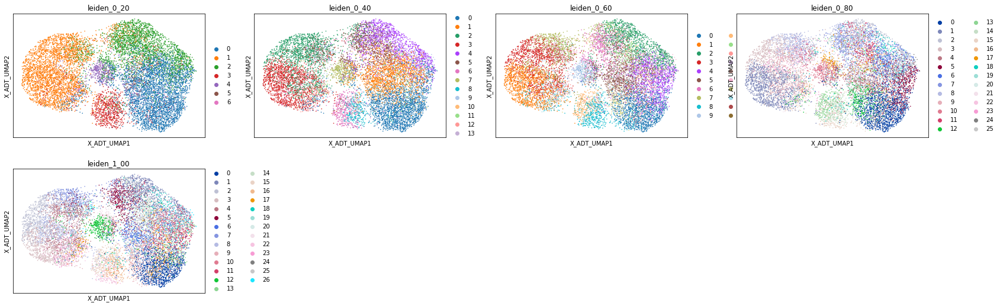

In [138]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', 
                color = adata_lineages[lineage].obs.columns[adata_lineages[lineage].obs.columns.str.contains('leiden')])


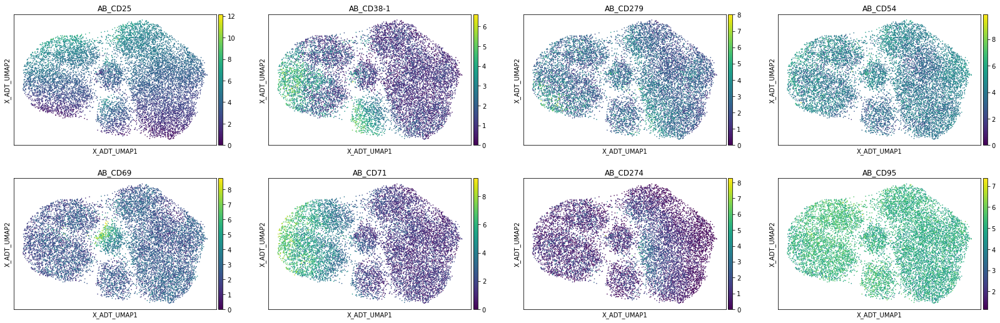

In [139]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)

In [105]:
act_clusters_all[lineage] = ('leiden_0_20', ['1'])

In [106]:
adata_lineages[lineage].obs[act_clusters_all[lineage][0]].isin(act_clusters_all[lineage][1])

AAAGTAGCACGTGAGA-1-gPlexA1    False
AACCATGTCACTGGGC-1-gPlexA1     True
AACCGCGGTCTCCACT-1-gPlexA1     True
AACTGGTCAGGGCATA-1-gPlexA1    False
AACTTTCAGGGCTTGA-1-gPlexA1    False
                              ...  
TTAGTTCAGCTGATAA-1-gPlexK7    False
TTAGTTCCATCCTTGC-1-gPlexK7     True
TTCTCCTTCAACGAAA-1-gPlexK7    False
TTTCCTCAGGGTCGAT-1-gPlexK7     True
TTTGGTTGTCTAGAGG-1-gPlexK7    False
Name: leiden_0_20, Length: 11798, dtype: bool

In [108]:
lineage.replace(' ', '-')

'CD4-Treg'

In [ ]:
lineage

In [109]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_%s.h5ad' % lineage.replace(' ', '-'))
print(outfn)

../../../Data/PerDataset/COMBAT/ADT_TP10KCLR_ClusterActivation_CD4-Treg.h5ad


In [110]:
sc.write(filename = outfn, adata = adata_lineages[lineage])

In [140]:
lineage  = 'CD4 Conv'

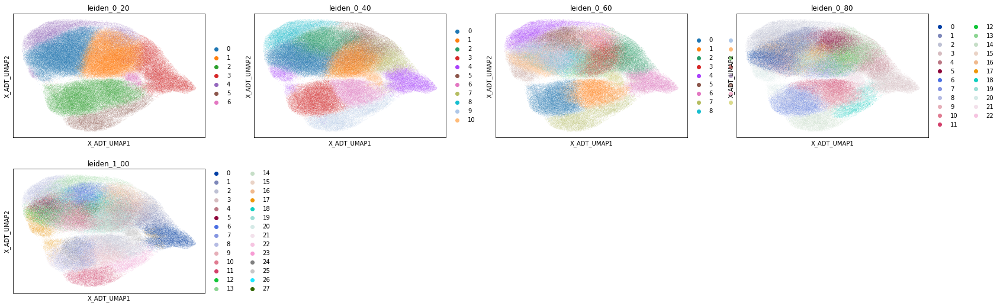

In [141]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', 
                color = adata_lineages[lineage].obs.columns[adata_lineages[lineage].obs.columns.str.contains('leiden')])


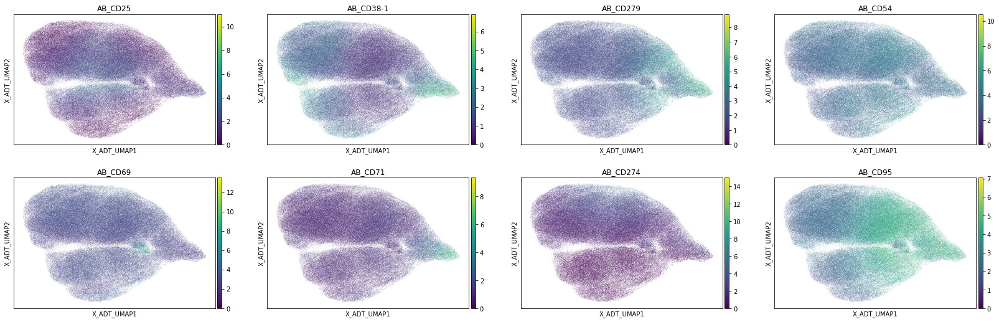

In [142]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)

In [144]:
act_clusters_all[lineage] = ('leiden_0_20', ['3'])

In [145]:
adata_lineages[lineage].obs[act_clusters_all[lineage][0]].isin(act_clusters_all[lineage][1])

AAACCTGCAGCTCGAC-1-gPlexA1    False
AAACCTGCATCTATGG-1-gPlexA1     True
AAACCTGGTCTCTCTG-1-gPlexA1    False
AAACCTGTCAGAGCTT-1-gPlexA1    False
AAACCTGTCCAAACAC-1-gPlexA1    False
                              ...  
TTTGGTTGTCAGGACA-1-gPlexK7    False
TTTGGTTGTCTGCAAT-1-gPlexK7    False
TTTGGTTGTTGTCGCG-1-gPlexK7    False
TTTGGTTTCCTCAACC-1-gPlexK7    False
TTTGGTTTCTCGATGA-1-gPlexK7    False
Name: leiden_0_20, Length: 257087, dtype: bool

In [ ]:
lineage

In [146]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_%s.h5ad' % lineage.replace(' ', '-'))
print(outfn)

../../../Data/PerDataset/COMBAT/ADT_TP10KCLR_ClusterActivation_CD4-Conv.h5ad


In [147]:
sc.write(filename = outfn, adata = adata_lineages[lineage])

In [148]:
lineage  = 'CD8 Conv'

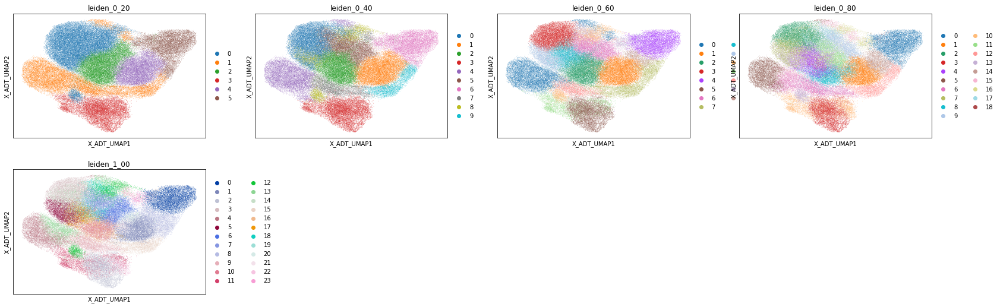

In [149]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', 
                color = adata_lineages[lineage].obs.columns[adata_lineages[lineage].obs.columns.str.contains('leiden')])


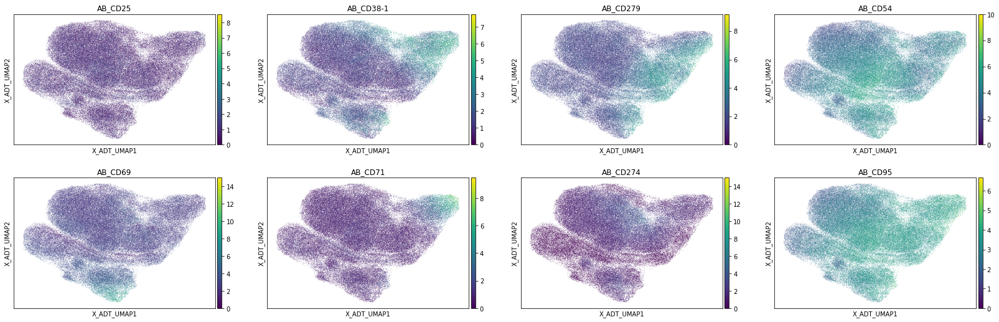

In [150]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)

In [151]:
act_clusters_all[lineage] = ('leiden_0_40', ['1', '9', '6'])

In [152]:
adata_lineages[lineage].obs[act_clusters_all[lineage][0]].isin(act_clusters_all[lineage][1])

AAACCTGAGCGGATCA-1-gPlexA1    False
AAACCTGTCACCGGGT-1-gPlexA1    False
AAACCTGTCGGTTCGG-1-gPlexA1    False
AAACGGGAGAAGGGTA-1-gPlexA1    False
AAACGGGAGACTAGGC-1-gPlexA1    False
                              ...  
TTTGGTTAGGGCATGT-1-gPlexK7    False
TTTGGTTCAAACTGCT-1-gPlexK7    False
TTTGTCACACCACGTG-1-gPlexK7    False
TTTGTCAGTTACCGAT-1-gPlexK7    False
TTTGTCATCCTCTAGC-1-gPlexK7    False
Name: leiden_0_40, Length: 105358, dtype: bool

In [153]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_%s.h5ad' % lineage.replace(' ', '-'))
print(outfn)

../../../Data/PerDataset/COMBAT/ADT_TP10KCLR_ClusterActivation_CD8-Conv.h5ad


In [154]:
sc.write(filename = outfn, adata = adata_lineages[lineage])

In [155]:
lineage  = 'Other'

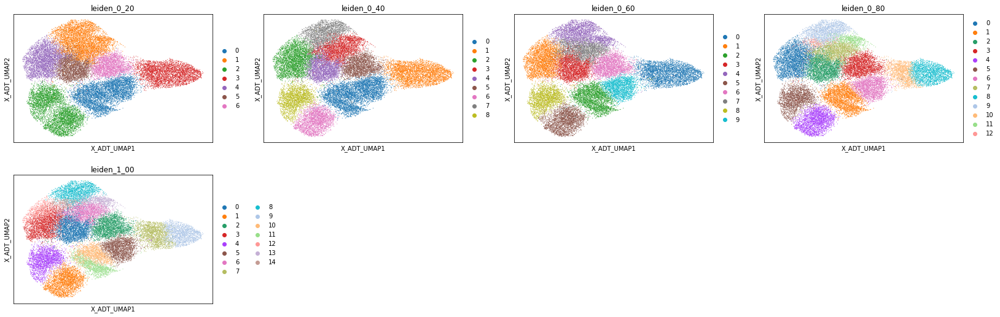

In [156]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', 
                color = adata_lineages[lineage].obs.columns[adata_lineages[lineage].obs.columns.str.contains('leiden')])


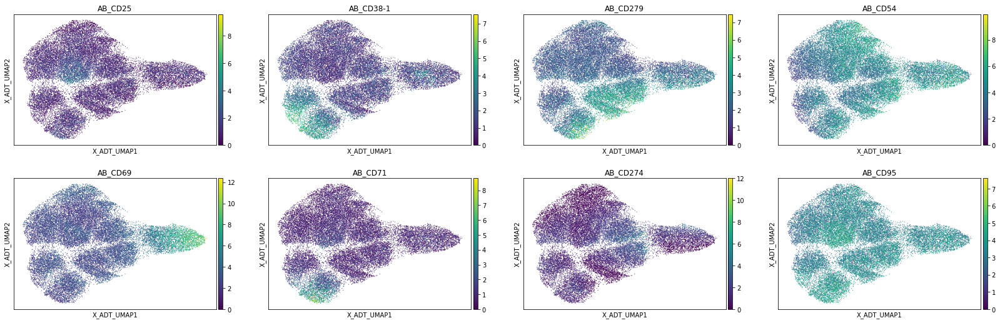

In [157]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)

In [158]:
act_clusters_all[lineage] = ('leiden_0_20', ['2', '0'])

In [159]:
adata_lineages[lineage].obs[act_clusters_all[lineage][0]].isin(act_clusters_all[lineage][1])

AAACCTGTCCTTGCCA-1-gPlexA1    False
AAACGGGTCTCTTGAT-1-gPlexA1    False
AAAGATGGTAGCTGCC-1-gPlexA1    False
AAAGATGGTCATGCAT-1-gPlexA1     True
AAAGATGTCCGTACAA-1-gPlexA1     True
                              ...  
TTGCGTCAGCGCCTCA-1-gPlexK7    False
TTGCGTCCATGGTTGT-1-gPlexK7    False
TTGGAACAGTTAGGTA-1-gPlexK7    False
TTGGCAAAGCGAAGGG-1-gPlexK7    False
TTTCCTCTCTACTTAC-1-gPlexK7    False
Name: leiden_0_20, Length: 26682, dtype: bool

In [160]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_%s.h5ad' % lineage.replace(' ', '-'))
print(outfn)

../../../Data/PerDataset/COMBAT/ADT_TP10KCLR_ClusterActivation_Other.h5ad


In [161]:
sc.write(filename = outfn, adata = adata_lineages[lineage])

#### Unharmonized

In [64]:
lineage= 'CD4 Treg'

sc.pp.neighbors(adata_lineages[lineage], n_neighbors=10, n_pcs=6, use_rep='X_pca'#'X_pca_harmony'
               )
sc.tl.umap(adata_lineages[lineage])
adata_lineages[lineage].obsm['X_ADT_UMAP'] = adata_lineages[lineage].obsm['X_umap']
for res in np.arange(0.2, 1.2, 0.2):
    print(res)
    sc.tl.leiden(adata_lineages[lineage], resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))


0.2
0.4
0.6000000000000001
0.8
1.0


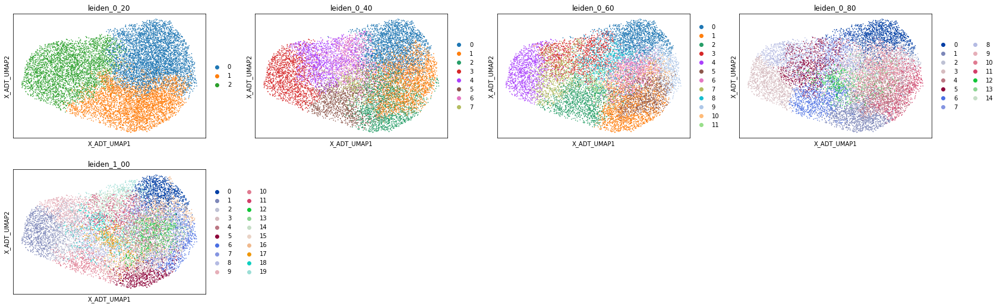

In [65]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', 
                color = adata_lineages[lineage].obs.columns[adata_lineages[lineage].obs.columns.str.contains('leiden')])


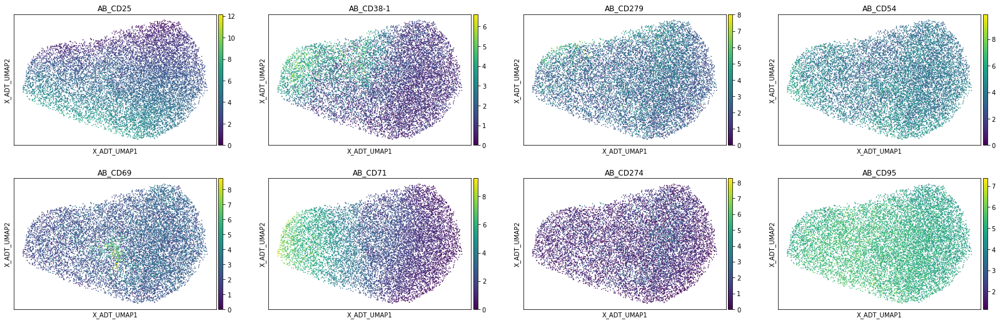

In [66]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)

## By broader lineage classes (CD4, CD8, Other)

Redo to group CD4 Convs and Tregs

In [ ]:
# adata_lineages = {}

In [217]:
act_clusters_all_broad = {}

In [209]:
lineage_gating_broad = lineage_gating.copy()

lineage_gating_broad.loc[lineage_gating_broad['class']=='CD4 Treg', 'class'] = 'CD4'
lineage_gating_broad.loc[lineage_gating_broad['class']=='CD4 Conv', 'class'] = 'CD4'
lineage_gating_broad.loc[lineage_gating_broad['class']=='CD8 Conv', 'class'] = 'CD8'


In [210]:
lineage_gating_broad['class'].unique()

array(['CD8', 'CD4', 'Other'], dtype=object)

In [211]:
lineage_gating_broad['class'].value_counts()

CD4      268885
CD8      105358
Other     26682
Name: class, dtype: int64

In [ ]:
harmony_vars

In [ ]:
adata_lineages['CD4 Treg']

CD4


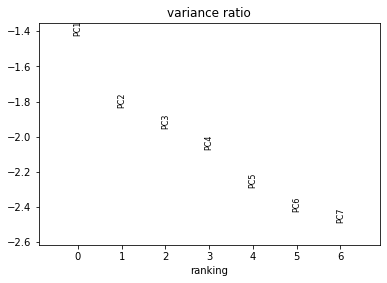

2024-02-15 10:39:38,157 - harmonypy - INFO - Iteration 1 of 30
2024-02-15 10:44:23,785 - harmonypy - INFO - Iteration 2 of 30
2024-02-15 10:49:08,710 - harmonypy - INFO - Iteration 3 of 30
2024-02-15 10:52:55,352 - harmonypy - INFO - Iteration 4 of 30
2024-02-15 10:56:41,213 - harmonypy - INFO - Iteration 5 of 30
2024-02-15 11:00:00,745 - harmonypy - INFO - Iteration 6 of 30
2024-02-15 11:03:19,084 - harmonypy - INFO - Iteration 7 of 30
2024-02-15 11:06:12,520 - harmonypy - INFO - Iteration 8 of 30
2024-02-15 11:09:10,202 - harmonypy - INFO - Iteration 9 of 30
2024-02-15 11:11:49,712 - harmonypy - INFO - Iteration 10 of 30
2024-02-15 11:14:21,183 - harmonypy - INFO - Iteration 11 of 30
2024-02-15 11:16:58,773 - harmonypy - INFO - Iteration 12 of 30
2024-02-15 11:19:16,898 - harmonypy - INFO - Iteration 13 of 30
2024-02-15 11:21:35,254 - harmonypy - INFO - Iteration 14 of 30
2024-02-15 11:23:58,489 - harmonypy - INFO - Iteration 15 of 30
2024-02-15 11:26:29,428 - harmonypy - INFO - Iter

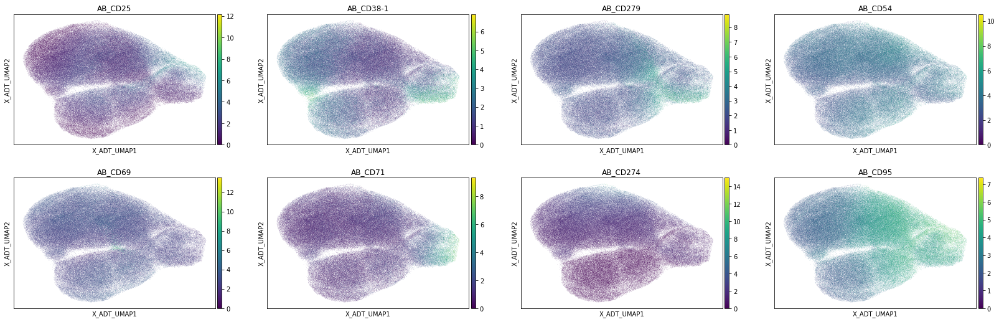

0.2
0.4
0.6000000000000001
0.8
1.0


In [213]:
for lineage in ['CD4']: #lineage_gating['class'].unique():
    print(lineage)
    
    ind_lineage = lineage_gating_broad[lineage_gating_broad['class']==lineage].index
    adata_lineages[lineage] = adata_ADT[ind_lineage, adt_markers].copy()
    
    sc.tl.pca(adata_lineages[lineage], zero_center=True)
    sc.pl.pca_variance_ratio(adata_lineages[lineage], log=True, n_pcs=6)

    adata_lineages[lineage].obs[harmony_vars] = adata_lineages[lineage].obs[harmony_vars].astype(str)
    sc.external.pp.harmony_integrate(adata_lineages[lineage],  harmony_vars, max_iter_harmony = 30,
                                    # nclust = 10
                                    )

    sc.pp.neighbors(adata_lineages[lineage], n_neighbors=10, n_pcs=6, use_rep='X_pca_harmony')
    sc.tl.umap(adata_lineages[lineage])
    adata_lineages[lineage].obsm['X_ADT_UMAP'] = adata_lineages[lineage].obsm['X_umap']
    
    sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)
    for res in np.arange(0.2, 1.2, 0.2):
        print(res)
        sc.tl.leiden(adata_lineages[lineage], resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))
        
    

In [214]:
lineage  = 'CD4'

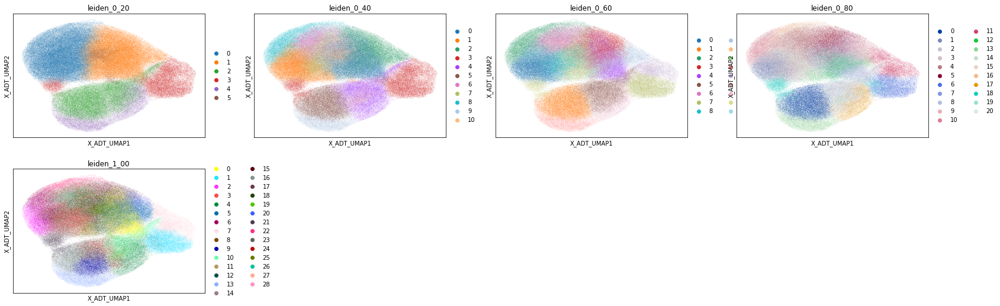

In [215]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', 
                color = adata_lineages[lineage].obs.columns[adata_lineages[lineage].obs.columns.str.contains('leiden')])


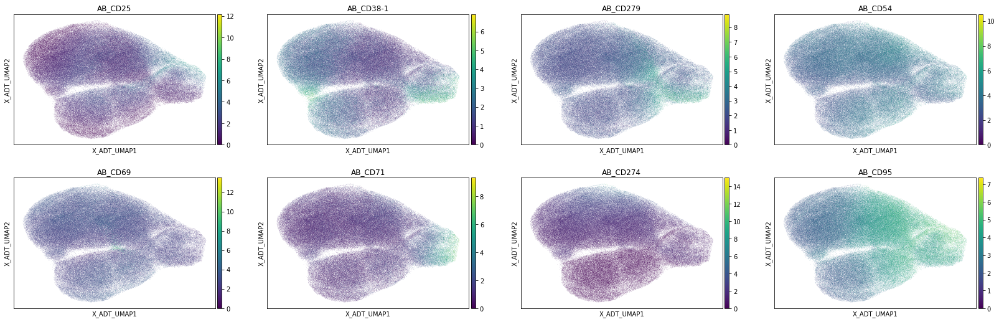

In [216]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)

In [218]:
lineage

'CD4'

In [219]:
act_clusters_all_broad[lineage] = ('leiden_0_20', ['3'])

In [220]:
adata_lineages[lineage].obs[act_clusters_all_broad[lineage][0]].isin(act_clusters_all_broad[lineage][1])

AAACCTGCAGCTCGAC-1-gPlexA1    False
AAACCTGCATCTATGG-1-gPlexA1    False
AAACCTGGTCTCTCTG-1-gPlexA1    False
AAACCTGTCAGAGCTT-1-gPlexA1    False
AAACCTGTCCAAACAC-1-gPlexA1    False
                              ...  
TTTGGTTGTCTAGAGG-1-gPlexK7    False
TTTGGTTGTCTGCAAT-1-gPlexK7    False
TTTGGTTGTTGTCGCG-1-gPlexK7     True
TTTGGTTTCCTCAACC-1-gPlexK7    False
TTTGGTTTCTCGATGA-1-gPlexK7    False
Name: leiden_0_20, Length: 268885, dtype: bool

In [ ]:
lineage.replace(' ', '-')

In [ ]:
lineage

In [221]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_%s.h5ad' % lineage.replace(' ', '-'))
print(outfn)

../../../Data/PerDataset/COMBAT/ADT_TP10KCLR_ClusterActivation_CD4.h5ad


In [222]:
sc.write(filename = outfn, adata = adata_lineages[lineage])

## Output labels

In [186]:
output = pd.DataFrame(columns = ['Activation_Cluster_ByLineage', #'Activation_Cluster_ByLineageBroad'
                                ],
             index = adata_ADT.obs.index)

In [187]:
for lineage in lineage_gating['class'].unique():
    output.loc[adata_lineages[lineage].obs.index, 'Activation_Cluster_ByLineage'] = adata_lineages[lineage].obs[
        act_clusters_all[lineage][0]].isin(act_clusters_all[lineage][1])

In [189]:
output.value_counts()

Activation_Cluster_ByLineage
False                           326819
True                             74106
dtype: int64

In [228]:
pd.crosstab(lineage_gating.loc[adata_ADT.obs.index, 'class'],
           output.loc[adata_ADT.obs.index, 'Activation_Cluster_ByLineage'])

Activation_Cluster_ByLineage,False,True
class,,
CD4 Conv,224520,32567
CD4 Treg,8306,3492
CD8 Conv,76948,28410
Other,17045,9637


In [223]:
# Update so CD4 Convs and Tregs are grouped together
output['Activation_Cluster_ByLineageBroad'] = output['Activation_Cluster_ByLineage']


for lineage in ['CD4']:
    output.loc[adata_lineages[lineage].obs.index, 'Activation_Cluster_ByLineageBroad'] = adata_lineages[lineage].obs[
        act_clusters_all_broad[lineage][0]].isin(act_clusters_all_broad[lineage][1])

In [226]:
output.value_counts()

Activation_Cluster_ByLineage  Activation_Cluster_ByLineageBroad
False                         False                                319333
True                          True                                  58506
                              False                                 15600
False                         True                                   7486
dtype: int64

In [229]:
pd.crosstab(lineage_gating_broad.loc[adata_ADT.obs.index, 'class'],
           output.loc[adata_ADT.obs.index, 'Activation_Cluster_ByLineageBroad'])

Activation_Cluster_ByLineageBroad,False,True
class,,
CD4,240940,27945
CD8,76948,28410
Other,17045,9637


In [227]:
pd.crosstab(lineage_gating.loc[adata_ADT.obs.index, 'class'],
           output.loc[adata_ADT.obs.index, 'Activation_Cluster_ByLineageBroad'])

Activation_Cluster_ByLineageBroad,False,True
class,,
CD4 Conv,234086,23001
CD4 Treg,6854,4944
CD8 Conv,76948,28410
Other,17045,9637


In [ ]:
# output['Activation_Cluster_ByLineageBroad'] = adata_ADT_filt.obs.loc[
#     output.index, act_clusters_all['All_Cells'][0]].isin(act_clusters_all['All_Cells'][1])



In [230]:
outfn = os.path.join(outdir, 'ActivationByClustering.tsv')
print(outfn)

../../../Data/PerDataset/COMBAT/ActivationByClustering.tsv


In [231]:
output.to_csv(outfn, sep='\t')

In [ ]:
pd.crosstab(lineage_gating.loc[adata_ADT.obs.index, 'class'],
           output.loc[adata_ADT.obs.index, 'Activation_Cluster_ByLineage'])

Activation_Cluster_ByLineage,False,True
class,,
CD4 Conv,224520,32567
CD4 Treg,8306,3492
CD8 Conv,76948,28410
Other,17045,9637


In [ ]:
pd.crosstab(lineage_gating.loc[adata_ADT.obs.index, 'class'],
           output.loc[adata_ADT.obs.index, 'Activation_Cluster_ByLineage'])

## Plot ADT/cluster heatmaps

In [190]:
for lineage in lineage_gating['class'].unique():
    print(lineage)

CD8 Conv
CD4 Conv
Other
CD4 Treg


In [191]:
adata_ADT_plot = sc.pp.scale(adata_ADT, zero_center=True, copy = True)


In [192]:
vmax = np.quantile(abs(adata_ADT_plot[:, adt_markers].X), 0.95)#adata_ADT_plot[:, adt_markers].X.max()
vmin = -vmax #adata_ADT_plot[:, adt_markers].X.min()

vmin, vmax

(-1.893249899148941, 1.893249899148941)

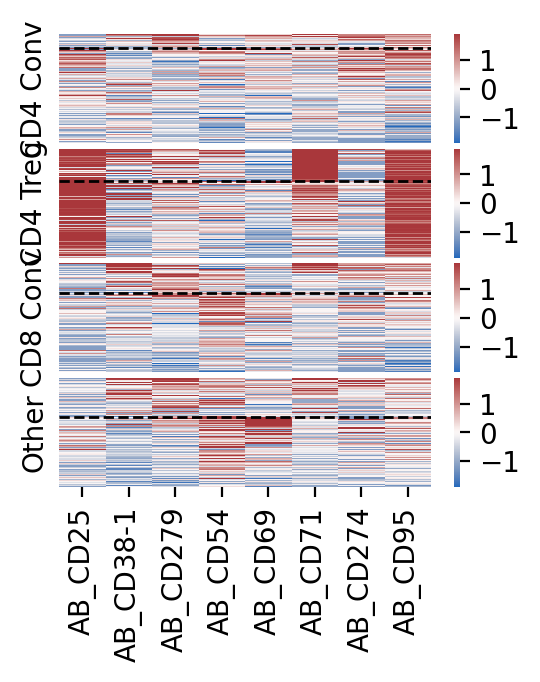

In [195]:
nrows = len(lineage_gating['class'].unique())

fig, axes = plt.subplots(dpi = 200, nrows = nrows, ncols = 1, figsize = (3, 3), 
                         gridspec_kw = {'hspace' : 0.05})

all_order = []
for i, lineage in enumerate(['CD4 Conv','CD4 Treg', 'CD8 Conv', 'Other']):

    ax = axes[i]
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
    
    g1 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==True]
    g2 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==False]
    g1 = list(pd.Series(adata_ADT_plot[g1, adt_markers].X.mean(axis = 1), index = g1).sort_values(ascending = False).index)
    g2 = list(pd.Series(adata_ADT_plot[g2, adt_markers].X.mean(axis = 1), index = g2).sort_values(ascending = False).index)
    
    ind_order = g1 + g2
    all_order += ind_order

    # ind_order = output.loc[ind_lineage, 'Activation_Cluster_ByLineage'].sort_values(ascending = False).index
    
    # if i ==0:
    #     cbar = True
    # else:
    #     cbar = False
    sns.heatmap(adata_ADT_plot[ind_order, adt_markers].X, cmap = 'vlag', 
                ax = ax, vmin = vmin, vmax = vmax)
    ax.set_yticks([])
    ax.set_ylabel(lineage)
    
    ax.hlines(y = len(g1), xmin = 0, xmax = len(adt_markers), color = 'black', 
              linestyle = 'dashed', linewidth = 1)
    
    if i == (nrows-1):
        ax.set_xticklabels(adt_markers, rotation = 90)
    else:
        ax.set_xticks([])


In [ ]:
row_colors

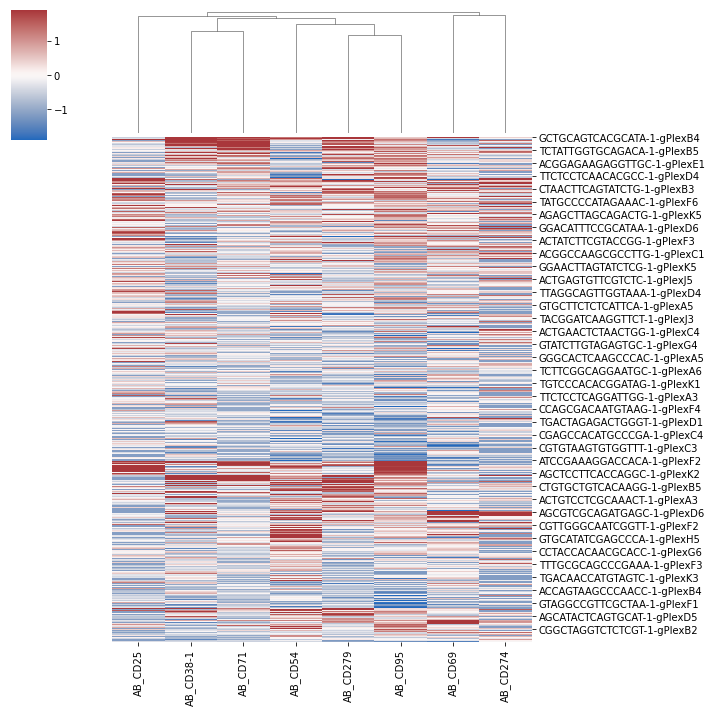

In [196]:
g = sns.clustermap(pd.DataFrame(adata_ADT_plot[all_order, adt_markers].X, index = all_order,
                            columns = adt_markers), row_cluster = False, vmin = vmin, vmax = vmax,
               cmap = 'vlag')

In [197]:
adt_order = list(pd.Series(adt_markers)[g.dendrogram_col.reordered_ind])

In [ ]:
adt_order

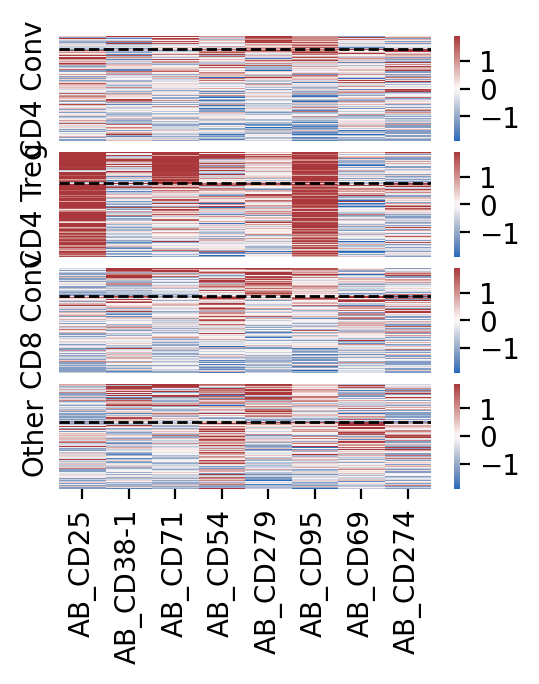

In [198]:
nrows = len(lineage_gating['class'].unique())

fig, axes = plt.subplots(dpi = 200, nrows = nrows, ncols = 1, figsize = (3, 3), 
                         gridspec_kw = {'hspace' : 0.1})

all_order = []
for i, lineage in enumerate(['CD4 Conv','CD4 Treg', 'CD8 Conv', 'Other']):

    ax = axes[i]
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
    
    g1 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==True]
    g2 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==False]
    g1 = list(pd.Series(adata_ADT_plot[g1, adt_order].X.mean(axis = 1), index = g1).sort_values(ascending = False).index)
    g2 = list(pd.Series(adata_ADT_plot[g2, adt_order].X.mean(axis = 1), index = g2).sort_values(ascending = False).index)
    
    ind_order = g1 + g2
    all_order += ind_order

    # ind_order = output.loc[ind_lineage, 'Activation_Cluster_ByLineage'].sort_values(ascending = False).index
    
    # if i ==0:
    #     cbar = True
    # else:
    #     cbar = False
    sns.heatmap(adata_ADT_plot[ind_order, adt_order].X, cmap = 'vlag', 
                ax = ax, vmin = vmin, vmax = vmax)
    ax.set_yticks([])
    ax.set_ylabel(lineage)
    
    ax.hlines(y = len(g1), xmin = 0, xmax = len(adt_order), color = 'black', 
              linestyle = 'dashed', linewidth = 1)
    
    if i == (nrows-1):
        ax.set_xticklabels(adt_order, rotation = 90)
    else:
        ax.set_xticks([])


In [ ]:
fig, ax = plt.subplots(dpi =200)

sns.heatmap(adata_ADT_plot[ind_order, adt_order].X, cmap = 'vlag', 
            ax = ax, vmin = vmin, vmax = vmax, )
ax.set_yticks([])
ax.set_ylabel(lineage)

ax.hlines(y = len(g1), xmin = 0, xmax = len(adt_order), color = 'black', 
          linestyle = 'dashed', linewidth = 1)

if i == (nrows-1):
    ax.set_xticklabels(adt_order, rotation = 90)
else:
    ax.set_xticks([])

    

In [ ]:
# palette = sns.color_palette("husl")

# palette = sns.color_palette("BuPu_r")

In [ ]:
adata_lineages[lineage].uns['%s_colors' % cluster_col]

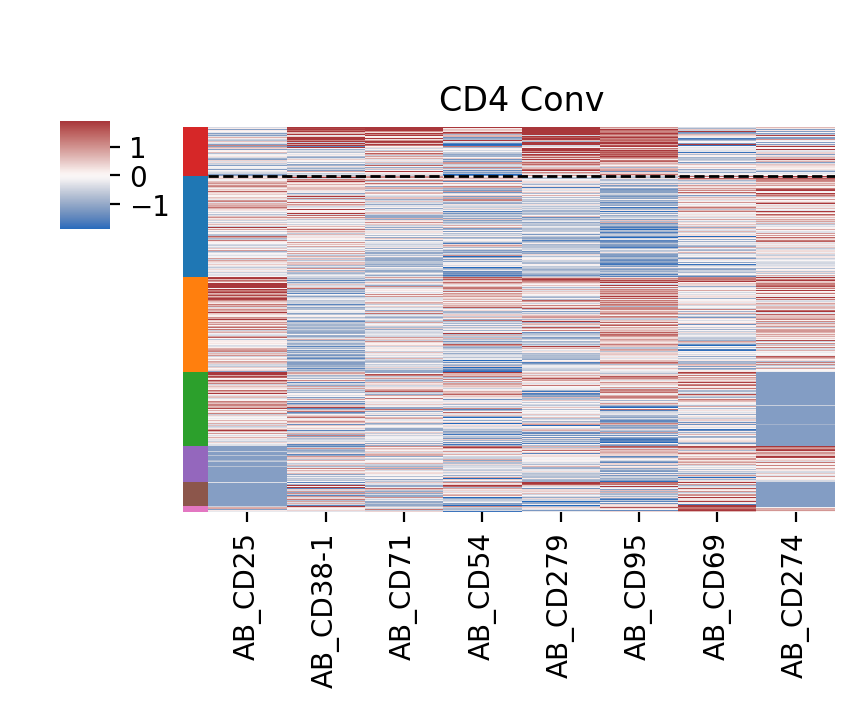

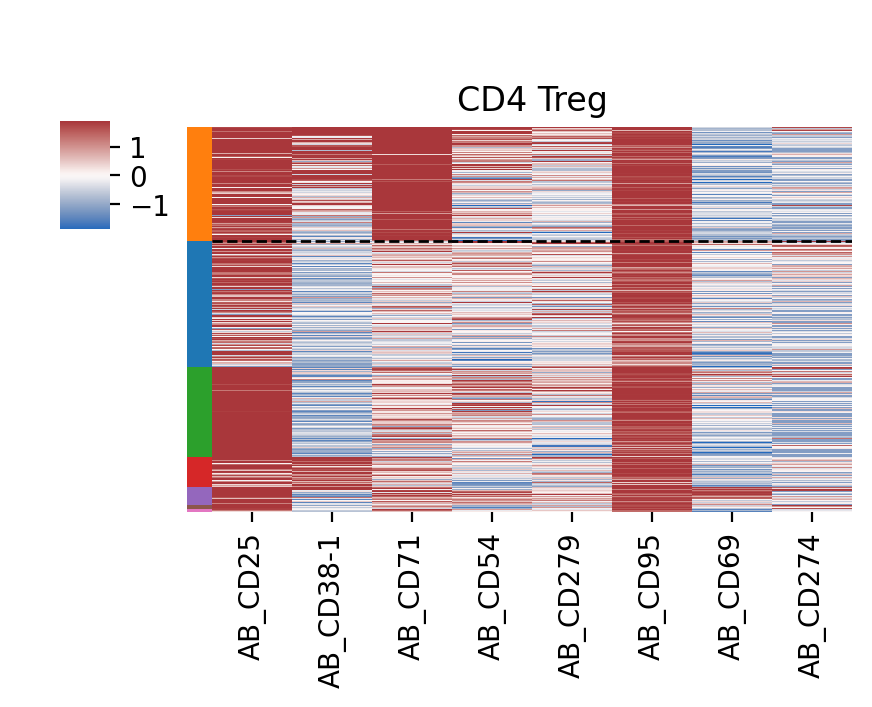

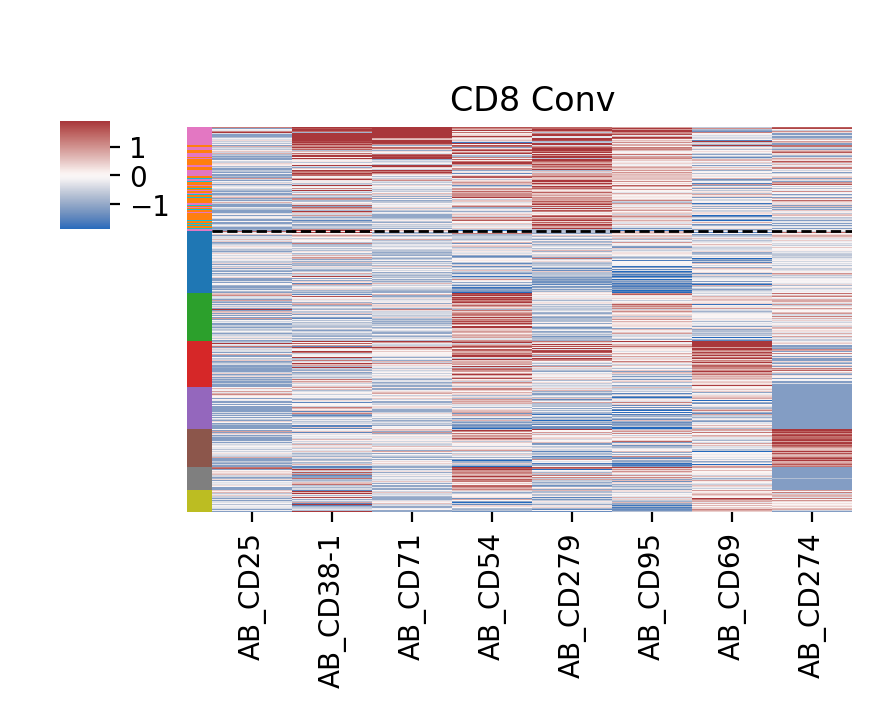

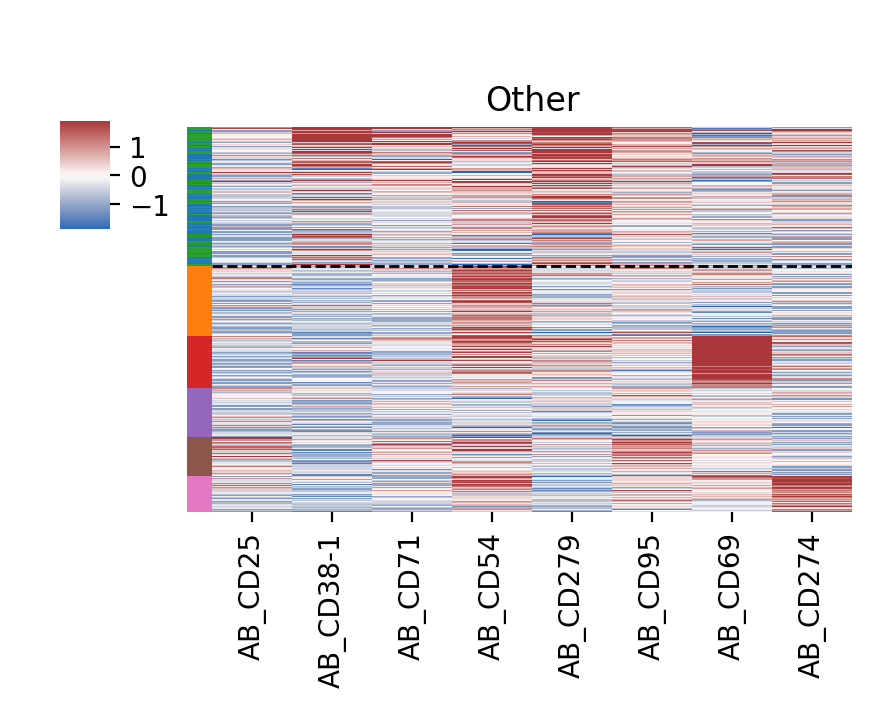

In [199]:
for i, lineage in enumerate(['CD4 Conv','CD4 Treg', 'CD8 Conv', 'Other']):


    cluster_col = act_clusters_all[lineage][0]
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index

    g1 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==True]
    g2 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==False]
    g1 = list(pd.Series(adata_ADT_plot[g1, adt_markers].X.mean(axis = 1), index = g1).sort_values(ascending = False).index)
    g2 = list(pd.Series(adata_ADT_plot[g2, adt_markers].X.mean(axis = 1), index = g2).sort_values(ascending = False).index)
    # ind_order = g1 + g2
    # Sort within clusters
    g2_order = pd.DataFrame(adata_lineages[lineage].obs.loc[g2, cluster_col], index = g2)
    g2_order['mean_adt'] = adata_ADT_plot[g2, adt_markers].X.mean(axis = 1)
    g2_final = list(g2_order.sort_values([cluster_col, 'mean_adt'], ascending = [True, False]).index)
    ind_order = g1 + g2_final

    # palette = sns.color_palette("tab20",
    #              n_colors = len(adata_lineages[lineage].obs.loc[ind_order, cluster_col].unique()))
    figsize = (5, 3)

    with rc_context({"figure.dpi" : 200}):

        g = sns.clustermap(adata_ADT_plot[ind_order, adt_order].X, cmap = 'vlag', 
                       row_colors = [adata_lineages[lineage].uns['%s_colors' % cluster_col][i]# palette[i] 
                                     for i in 
                                     adata_lineages[lineage].obs.loc[ind_order, cluster_col].astype('int')],
                           figsize = figsize,
                       vmin = vmin, vmax = vmax, row_cluster = False, col_cluster = False,
                                      cbar_pos=(0.07, 0.6, 0.05, 0.18))


        ax = g.ax_heatmap
        ax.hlines(y = len(g1), xmin = 0, xmax = len(adt_markers), color = 'black', 
                  linestyle = 'dashed', linewidth = 1 )
        ax.set_yticks([])
        ax.set_xticklabels(adt_order, rotation = 90)
        ax.set_title(lineage)

In [200]:
all_order = []
all_clusters = []
n_clusters = 0
for i, lineage in enumerate(['CD4 Conv','CD4 Treg', 'CD8 Conv', 'Other']):
    
    cluster_col = act_clusters_all[lineage][0]
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index

    g1 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==True]
    g2 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==False]
    g1 = list(pd.Series(adata_ADT_plot[g1, adt_markers].X.mean(axis = 1), index = g1).sort_values(ascending = False).index)
    g2 = list(pd.Series(adata_ADT_plot[g2, adt_markers].X.mean(axis = 1), index = g2).sort_values(ascending = False).index)
    # ind_order = g1 + g2
    # Sort within clusters
    g2_order = pd.DataFrame(adata_lineages[lineage].obs.loc[g2, cluster_col], index = g2)
    g2_order['mean_adt'] = adata_ADT_plot[g2, adt_markers].X.mean(axis = 1)
    g2_final = list(g2_order.sort_values([cluster_col, 'mean_adt'], ascending = [True, False]).index)
    ind_order = g1 + g2_final
    
    all_order += ind_order
    all_clusters += list(adata_lineages[lineage].obs.loc[ind_order, cluster_col].astype('int') + n_clusters)
    n_clusters += len(adata_lineages[lineage].obs.loc[ind_order, cluster_col].astype('int').unique())


In [ ]:
set(all_clusters)

In [202]:
palette = sns.color_palette("tab20",
             n_colors = len(set(all_clusters)))


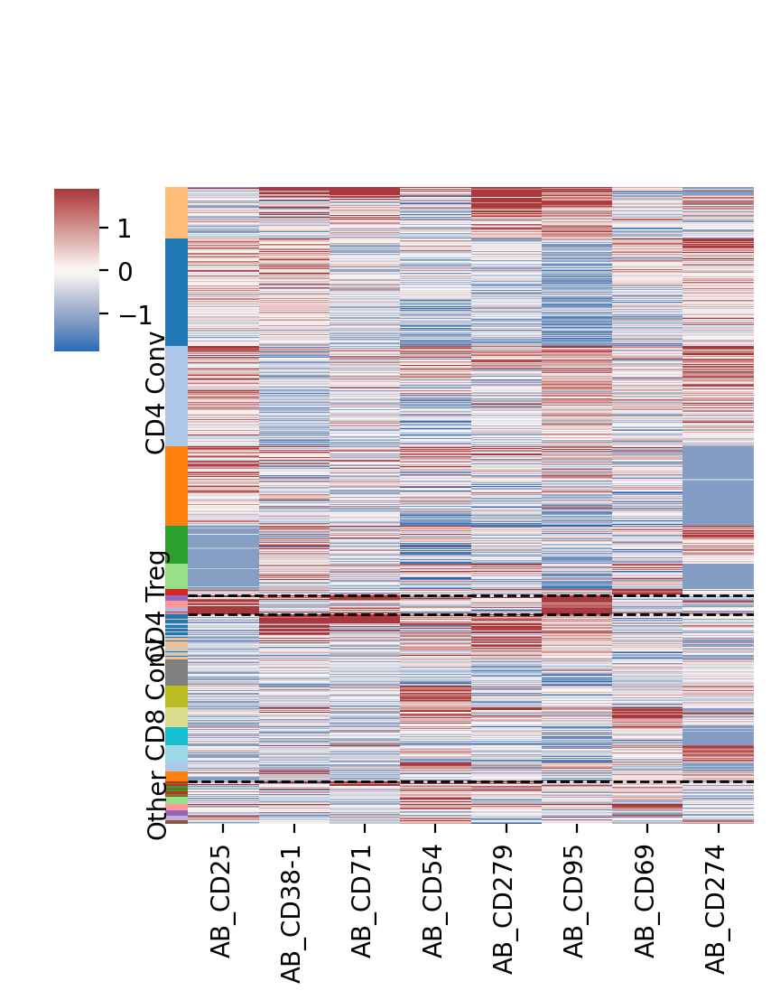

In [203]:

figsize = (5, 5)

with rc_context({"figure.dpi" : 200}):

    g = sns.clustermap(adata_ADT_plot[all_order, adt_order].X, cmap = 'vlag', 
           row_colors =  [palette[i] 
                         for i in all_clusters],
               figsize = figsize,
           vmin = vmin, vmax = vmax, row_cluster = False, col_cluster = False,
                          cbar_pos=(0.07, 0.6, 0.05, 0.18))

    row_base = 0
    for i, lineage in enumerate(['CD4 Conv','CD4 Treg', 'CD8 Conv', 'Other']):
        ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
        len(ind_lineage)

        ax = g.ax_heatmap
        if lineage != 'Other':
            ax.hlines(y = row_base + len(ind_lineage), xmin = 0, xmax = len(adt_markers), color = 'black', 
                      linestyle = 'dashed', 
                      linewidth = 1)
        ax.text(-.6, (len(ind_lineage)/2 + row_base), lineage, rotation = 90, va = 'center')

        row_base += len(ind_lineage)
    ax.set_yticks([])
    ax.set_xticklabels(adt_order, rotation = 90)
    # ax.set_title(lineage)

# Compare proteins with TCAT usages

In [128]:
aim_assoc_geps = ['Early-Activation',
'ISG',
'BCL2-Survival',
'Treg',
'OX40/EBI3-Activation',
'Cytoskeleton',
'Th17',
'ICOS/CD38-Activation',
'Exhaustion',
'RGCC/MYADM',
'CCR10-Migration',
'CellCycle-S',
'Tfh-2',
'CTLA4+/CD38+-Activation',
'HeatShock',
'Tph',
'Multi-Cytokine',
'TIMD4/TIM3-Activation',
'Th17-2',
'Th2-2',
'Metallothionein',
'CellCycle-Late-S',
'CellCycle-G2M',
                   ]

In [129]:
cc_assoc_geps = ['CTLA4+/CD38+-Activation', 'Cytoskeleton', 'Early-Activation',
       'Exhaustion', 'HLA', 'ICOS/CD38-Activation', 'IL10/IL19-Secretion',
       'Metallothionein', 'OX40/EBI3-Activation', 'TIMD4/TIM3-Activation',
       'Th17-2', 'Tph']

In [130]:
gep_info = read_dataset_log('cGEP_Name')
rename_map = dict(zip(gep_info['cGep_Name'], gep_info['Short_Name']))


In [132]:
dataset = 'COMBAT'

In [133]:
usage = pd.read_csv(params.loc[dataset, 'tcat_fn'], index_col = 0, sep = '\t')

In [134]:
usage.columns = usage.columns.map(rename_map)
usage_norm = usage.div(usage.sum(axis=1), axis=0)


In [135]:
usage_norm

,CellCycle-G2M,Translation,HLA,ISG,Mito,Doublet-RBC,gdT-Blood,CellCycle-S,Cytotoxic,Doublet-Platelet,...,Tfh-2,OX40/EBI3-Activation,TXNIP/H1FX,YPEL5/JUNB,Doublet-Fibroblast,SOX4/TOX2,CD40LG/TXNIP,Tph,Exhaustion,Tfh-1
AAACCTGAGCGGATCA-1-gPlexA1,1.144482e-04,1.971281e-04,5.044677e-02,0.000394,2.976725e-07,0.000678,0.026504,4.564638e-04,0.328680,0.000905,...,0.004894,2.548915e-03,7.330879e-04,0.002878,0.007332,0.002146,0.002679,0.016983,0.016611,0.012907
AAACCTGCAGCTCGAC-1-gPlexA1,1.336566e-04,2.344784e-01,2.651128e-03,0.011165,4.850446e-06,0.000582,0.012246,2.683000e-03,0.005275,0.001425,...,0.003794,1.084296e-02,4.420491e-02,0.014869,0.001485,0.005787,0.031758,0.004158,0.001973,0.007829
AAACCTGCATCTATGG-1-gPlexA1,7.337412e-05,1.113615e-02,6.764924e-02,0.002802,2.252025e-04,0.001020,0.034474,1.004606e-03,0.120184,0.001089,...,0.009841,1.385960e-03,4.684737e-03,0.004597,0.005090,0.001117,0.057629,0.006502,0.012211,0.017336
AAACCTGGTCTCTCTG-1-gPlexA1,5.242861e-04,2.144546e-01,4.635892e-03,0.026641,7.475370e-06,0.000764,0.006035,4.993645e-03,0.010866,0.002153,...,0.011710,5.398044e-02,2.123096e-02,0.004090,0.001097,0.000952,0.017101,0.003815,0.002443,0.010850
AAACCTGTCACCGGGT-1-gPlexA1,7.837790e-04,4.647595e-02,6.412744e-02,0.002578,3.487247e-07,0.001031,0.042210,4.321662e-04,0.082531,0.001161,...,0.002736,1.150384e-02,6.413874e-03,0.003572,0.000203,0.001019,0.002647,0.001083,0.056630,0.004602
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTTCCTCAACC-1-gPlexK7,8.964144e-05,5.395227e-03,4.326647e-04,0.010966,3.318799e-02,0.005204,0.006816,5.165661e-04,0.003677,0.001567,...,0.027388,2.123830e-03,1.666258e-02,0.037414,0.003972,0.002907,0.047079,0.019746,0.008388,0.018650
TTTGGTTTCTCGATGA-1-gPlexK7,4.585419e-05,2.210963e-01,6.277849e-04,0.049601,3.746943e-03,0.000679,0.002611,4.301952e-03,0.002222,0.001932,...,0.005981,9.005970e-04,1.376983e-02,0.001170,0.005715,0.002237,0.036717,0.004540,0.002143,0.003885
TTTGTCACACCACGTG-1-gPlexK7,2.364674e-05,6.482716e-07,3.535708e-04,0.001310,1.308376e-05,0.000317,0.117327,3.685059e-05,0.447601,0.001026,...,0.001271,1.169283e-03,2.464411e-05,0.000297,0.000734,0.000178,0.004204,0.005480,0.005181,0.000359
TTTGTCAGTTACCGAT-1-gPlexK7,2.713134e-05,1.865784e-01,2.010769e-03,0.002665,8.989587e-05,0.000530,0.012411,6.476677e-04,0.015499,0.001061,...,0.001180,9.577475e-04,3.650257e-02,0.000304,0.000867,0.000673,0.002692,0.000521,0.002420,0.000472


In [136]:
activation_geps = sorted(list(set(aim_assoc_geps).intersection(cc_assoc_geps)))
activation_geps

['CTLA4+/CD38+-Activation',
 'Cytoskeleton',
 'Early-Activation',
 'Exhaustion',
 'ICOS/CD38-Activation',
 'Metallothionein',
 'OX40/EBI3-Activation',
 'TIMD4/TIM3-Activation',
 'Th17-2',
 'Tph']

In [140]:
overlap = (markers_magic.index).intersection(usage_norm.index)
len(overlap)

399599

0 CTLA4+/CD38+-Activation
1 Cytoskeleton
2 Early-Activation
3 Exhaustion
4 ICOS/CD38-Activation
5 Metallothionein
6 OX40/EBI3-Activation
7 TIMD4/TIM3-Activation
8 Th17-2
9 Tph


Text(0.5, 0.9, 'COMBAT')

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

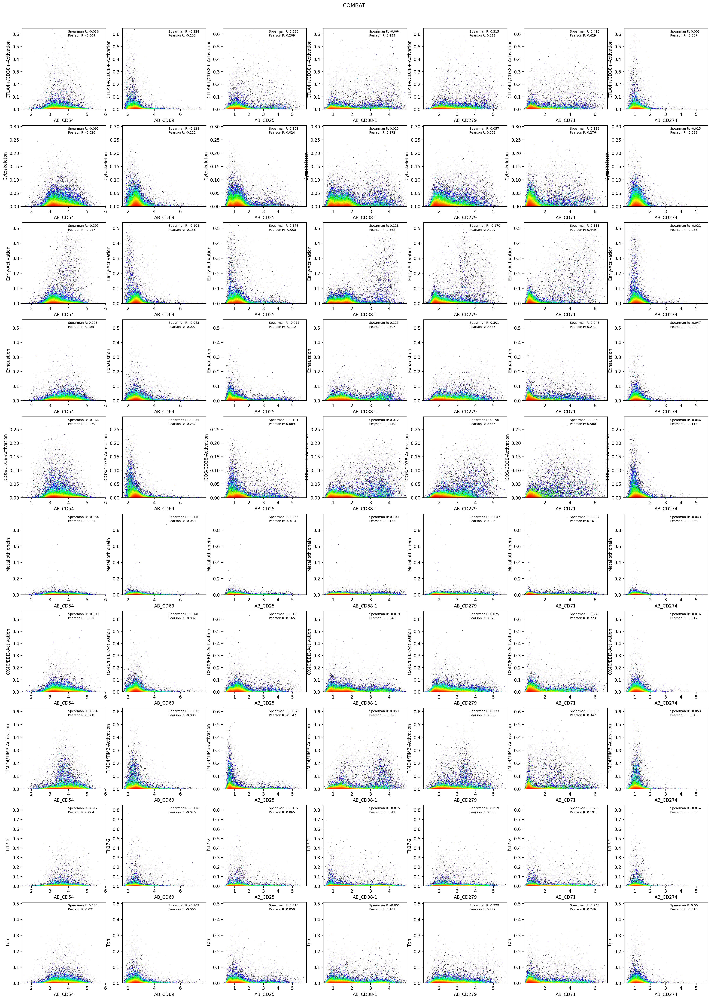

In [143]:
nrows = len(activation_geps)
ncols = len(markers_magic.columns)
fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(activation_geps),),
                                               nrows = nrows, ncols = ncols)

for i, gep in enumerate(activation_geps):
    print(i, gep)
    # i = i-1
    
    for j, p2 in enumerate(markers_magic.columns):
        # if j >= i:
        ax = axes[i, j]
        x = markers_magic.loc[overlap, p2]
        y = usage_norm.loc[overlap, gep]

        r_p, _ = pearsonr(x, y)
        r_s, _ = spearmanr(x, y)

        # ax.scatter(x, y)
        dsshow(pd.DataFrame({'x':x, 'y':y}), 
               ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
        # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
        ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
        ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
        ax.set_xlabel(p2)
        ax.set_ylabel(gep)
plt.suptitle(dataset,y = 0.9)